<div style="display: flex; background-color: RGB(255,114,0);" >
<h1 style="margin: auto; padding: 30px; ">ANALYSE DU STOCK ET DES VENTES DU SITE BOTTLENECK</h1>
</div>

# OBJECTIF DE CE NOTEBOOK

Bienvenue dans l'outil plébiscité par les analystes de données Jupyter.

Il s'agit d'un outil permettant de mixer et d'alterner codes, textes et graphique.

Cet outil est formidable pour plusieurs raisons:

+ il permet de tester des lignes de codes au fur et à mesure de votre rédaction, de constater immédiatement le résultat d'un instruction, de la corriger si nécessaire.
+ De rédiger du texte pour expliquer l'approche suivie ou les résultats d'une analyse et de le mettre en forme grâce à du code html ou plus simple avec **Markdown**
+ d'agrémenter de graphiques

Pour vous aider dans vos premiers pas à l'usage de Jupyter et de Python, nous avons rédigé ce notebook en vous indiquant les instructions à suivre.

Il vous suffit pour cela de saisir le code Python répondant à l'instruction donnée.

Vous verrez de temps à autre le code Python répondant à une instruction donnée mais cela est fait pour vous aider à comprendre la nature du travail qui vous est demandée.

Et garder à l'esprit, qu'il n'y a pas de solution unique pour résoudre un problème et qu'il y a autant de résolutions de problèmes que de développeurs ;)...



<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 1 - Importation des librairies et chargement des fichiers</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.1 - Importation des librairies</h3>
</div>

In [5]:
#Importation de la librairie Pandas
import pandas as pd

In [6]:
#Importation de la librairie plotly express
import matplotlib.pyplot as plt

In [7]:
#Importation de la librairie Numpy
import numpy as np

In [8]:
#Importation de Plotly Express
import plotly.express as px

In [9]:
#Importation de Seaborn
import seaborn as sns

In [10]:
import scipy.stats as stats

In [11]:
#Trouver dans Google l'instruction permettant d'afficher toutes les colonnes d'un dataframe
#Saisir, dans Google, les mots clés "display all columns dataframe Pandas", par exemple.
#Dans les résultats de la recherche, privilégiez les solutions provenants de Stack Overflow ou Medium

#Max colonne
pd.options.display.max_columns = None

#Max ligne
pd.options.display.max_rows = None

#Largeur Max colonne
pd.set_option('display.max_colwidth', None)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">1.2 - Chargements des fichiers</h3>
</div>

In [13]:
#Importation du fichier web.xlsx
df_web = pd.read_excel("web.xlsx")

#Importation du fichier erp.xlsx
df_erp = pd.read_excel("erp.xlsx")

#importation du fichier liaison.xlsx
df_liaison = pd.read_excel("liaison.xlsx")


C:\Users\Shiin\anaconda3\Lib\site-packages\openpyxl\worksheet\_read_only.py:81: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\Users\Shiin\anaconda3\Lib\site-packages\openpyxl\worksheet\_read_only.py:81: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\Users\Shiin\anaconda3\Lib\site-packages\openpyxl\worksheet\_read_only.py:81: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():


<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 2 - Analyse exploratoire des fichiers</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1 - Analyse exploratoire du fichier erp.xlsx</h3>
</div>

In [16]:
#Afficher les dimensions du dataset
print("Le tableau comporte {} observation(s) ou article(s)".format(df_erp.shape[0]))
print("Le tableau comporte {} colonne(s)".format(df_erp.shape[1]))

Le tableau comporte 825 observation(s) ou article(s)
Le tableau comporte 6 colonne(s)


In [17]:
#Consulter le nombre de colonnes
print("Le tableau comporte {} colonne(s)".format(df_erp.shape[1]))
print()

#La nature des données dans chacune des colonnes
nature_des_donnees = df_erp.dtypes
print("Nature des données de chaque colonne :")
print(nature_des_donnees)
print()

#Le nombre de valeurs présentes dans chacune des colonnes
nombre_de_valeurs = df_erp.count()
print("Nombre de valeurs présentes dans chaque colonne :")
print(nombre_de_valeurs)

Le tableau comporte 6 colonne(s)

Nature des données de chaque colonne :
product_id          int64
onsale_web          int64
price             float64
stock_quantity      int64
stock_status       object
purchase_price    float64
dtype: object

Nombre de valeurs présentes dans chaque colonne :
product_id        825
onsale_web        825
price             825
stock_quantity    825
stock_status      825
purchase_price    825
dtype: int64


In [18]:
#Afficher les 5 premières lignes de la table
df_erp.head()

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price
0,3847,1,24.2,16,instock,12.88
1,3849,1,34.3,10,instock,17.54
2,3850,1,20.8,0,outofstock,10.64
3,4032,1,14.1,26,instock,6.92
4,4039,1,46.0,3,outofstock,23.77


In [19]:
#Vérifier si il y a les lignes en doublons dans la colonne product_id


In [20]:
doublons = df_erp.loc[df_erp['product_id'].duplicated(keep=False),:]

# Afficher les doublons
print("Le nombre de doublon dans le dataframe :")
print(doublons.shape[0])
print()

# Comptabiliser le nb de valeur nulle
print("Le nombre de valeur null dans le dataframe :")
print(df_erp.isnull().sum())

Le nombre de doublon dans le dataframe :
0

Le nombre de valeur null dans le dataframe :
product_id        0
onsale_web        0
price             0
stock_quantity    0
stock_status      0
purchase_price    0
dtype: int64


In [21]:
#Afficher les valeurs distinctes de la colonne stock_status
valeurs_distinctes = df_erp['stock_status'].unique()
print("Les valeurs distinctes dans la colonne 'stock_status' : {} ".format(valeurs_distinctes))

Les valeurs distinctes dans la colonne 'stock_status' : ['instock' 'outofstock'] 


À quelle(s) autre(s) colonne(s) sont-elles liées ?
Elle est liée à la colonne stock_quantity

In [23]:
#Création d'une colonne "stock_status_2
#La valeur de cette deuxième colonne sera fonction de la valeur dans la colonne "stock_quantity"
#si la valeur de la colonne "stock_quantity" est nulle renseigner "outofstock" sinon mettre "instock"
df_erp['stock_status_2'] = df_erp['stock_quantity'].apply(lambda x: 'outofstock' if x == 0 else 'instock')

display(df_erp)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
0,3847,1,24.20,16,instock,12.88,instock
1,3849,1,34.30,10,instock,17.54,instock
2,3850,1,20.80,0,outofstock,10.64,outofstock
3,4032,1,14.10,26,instock,6.92,instock
4,4039,1,46.00,3,outofstock,23.77,instock
5,4040,1,34.30,12,instock,18.25,instock
6,4041,1,32.70,12,instock,17.57,instock
7,4042,1,31.20,15,instock,15.48,instock
8,4043,1,60.00,0,outofstock,29.45,outofstock
9,4045,1,42.60,5,instock,22.01,instock


In [24]:
#Vérifions que les 2 colonnes sont identiques:
#Les 2 colonnes sont strictement identiques si les valeurs de chaque ligne sont strictement identiques 2 à 2
#La comparaison de 2 colonnes peut se réaliser simplement avec l'instruction ci-dessous:
df_erp["stock_status"] == df_erp["stock_status_2"]

#Le résultat est l'affichage de True ou False pour chacune des lignes du dataset
#C'est un bon début, mais difficile à exploiter

0       True
1       True
2       True
3       True
4      False
5       True
6       True
7       True
8       True
9       True
10      True
11      True
12      True
13      True
14      True
15      True
16      True
17      True
18      True
19      True
20      True
21      True
22      True
23      True
24      True
25      True
26      True
27      True
28      True
29      True
30      True
31      True
32      True
33      True
34      True
35      True
36      True
37      True
38      True
39      True
40      True
41      True
42      True
43      True
44      True
45      True
46      True
47      True
48      True
49      True
50      True
51      True
52      True
53      True
54      True
55      True
56      True
57      True
58      True
59      True
60      True
61      True
62      True
63      True
64      True
65      True
66      True
67      True
68      True
69      True
70      True
71      True
72      True
73      True
74      True
75      True
76      True

In [25]:
#Mais il est possible de synthétiser ce résultat en effectuant la somme de cette colonne:
#True vaut 1 et False 0
#Nous devrions obtenir la somme de 825 qui correspond au nombre de lignes dans ce dataset
synthese_stock = df_erp["stock_status"] == df_erp["stock_status_2"]
synthese_stock.astype(int)
print(f"La synthèse de la colonne est de  {synthese_stock.sum()} au lieu des 825 valeurs")

La synthèse de la colonne est de  821 au lieu des 825 valeurs


In [26]:
#Si les colonnes ne sont absolument pas identiques ligne à ligne alors identifier la ligne en écart
##Dans ce cas je vous ce lien pour apprendre à réaliser des filtres dans Pandas:
##https://bitbucket.org/hrojas/learn-pandas/src/master/
##Lesson 3

# Comparaison des deux colonnes
comparaison = df_erp["stock_status"] == df_erp["stock_status_2"]

# Récupération des index des lignes où la comparaison est fausse
index_diff = df_erp.index[~comparaison]

# Affichage des index
print(f"Les index des lignes fausses:  {index_diff.tolist()} ")

# Affichage des lignes
df_erp.iloc[index_diff.tolist(),:]

Les index des lignes fausses:  [4, 398, 449, 573] 


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
4,4039,1,46.0,3,outofstock,23.77,instock
398,4885,1,18.7,0,instock,9.66,outofstock
449,4973,0,10.0,-10,outofstock,4.96,instock
573,5700,1,44.5,-1,outofstock,22.30,instock


In [27]:
  
# Parcourir les index où la comparaison est fausse
for idx in index_diff:
    
    # Vérification si la quantité de stock est négative
    if df_erp.loc[idx, "stock_quantity"] < 0:
        
        # Correction de la quantité
        df_erp.loc[idx, "stock_quantity"] = - df_erp.loc[idx, "stock_quantity"]
    
#Verification en utilisant le même code que plus haut pour afficher les problemes
df_erp.iloc[[4, 398, 449, 573],:]

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
4,4039,1,46.0,3,outofstock,23.77,instock
398,4885,1,18.7,0,instock,9.66,outofstock
449,4973,0,10.0,10,outofstock,4.96,instock
573,5700,1,44.5,1,outofstock,22.30,instock


In [28]:
#Corriger la ou les données incohérentes
for index in index_diff:
    if df_erp.at[index, "stock_status"] == "outofstock":
        df_erp.at[index, "stock_status"] = "instock"
    else:
        df_erp.at[index, "stock_status"] = "outofstock"
        
#Verification en utilisant le même code que plus haut pour afficher les problemes
synthese_stock = df_erp["stock_status"] == df_erp["stock_status_2"]
synthese_stock.astype(int)

print("La synthèse de la colonne est de  {} ".format(synthese_stock.sum()))

# Affichage des lignes
df_erp.iloc[[4, 398, 449, 573],:]

La synthèse de la colonne est de  825 


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
4,4039,1,46.0,3,instock,23.77,instock
398,4885,1,18.7,0,outofstock,9.66,outofstock
449,4973,0,10.0,10,instock,4.96,instock
573,5700,1,44.5,1,instock,22.30,instock


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1.1 - Analyse exploratoire de chaque variable du fichier erp.xlsx</h3>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1.1.1 - Analyse de la variable PRIX</h3>
</div>

In [31]:
###############
## LES PRIX  ##
###############

#Vérification des prix: Y a t-il des prix non renseignés, négatif ou nul?
prix_manquant = df_erp['price'].isnull().sum()
prix_negatif = df_erp['price'] < 0
prix_non_valide = prix_manquant + prix_negatif.sum()

#Afficher le nb de prix non renseignés, négatif ou nul"
print(f"Nombres d'article avec un prix non renseignés ou nul: {prix_manquant}") 
print(f"Nombres d'article avec un prix négatif : {prix_negatif.sum()}") 
print(f"Nombres d'article avec un prix non valide : {prix_non_valide}") 
print()

#Afficher le prix minimum de la colonne "price"
print(f"Prix minimum : {df_erp['price'].min()}€")

#Afficher le prix maximum de la colonne "price"
print(f"Prix maximum : {df_erp['price'].max()}€")

#Afficher le prix moyen de la colonne "price"
print(f"Prix moyen : {round(df_erp['price'].mean(),2)}€")

#Afficher le prix median de la colonne "price"
print(f"La médiane du prix est de : {df_erp['price'].median()}€")
print()


Nombres d'article avec un prix non renseignés ou nul: 0
Nombres d'article avec un prix négatif : 3
Nombres d'article avec un prix non valide : 3

Prix minimum : -20.0€
Prix maximum : 225.0€
Prix moyen : 32.19€
La médiane du prix est de : 24.3€



In [32]:
#Affichier les prix inférieurs à 0 (qu'est ce qu'il faut en faire ?)
prix_inferieur_a_zero = df_erp[df_erp['price'] < 0]

if not prix_inferieur_a_zero.empty:
    print("Prix inférieurs à 0 :")
    display(prix_inferieur_a_zero)
else:
    print("Il n'y a pas de prix inférieurs à 0.")

# Index prix négatif
index_price_diff = df_erp.index[df_erp['price'] < 0]

# Suppression des lignes avec prix négatif
for prx in index_price_diff :
    #df_erp.at[prx,'price'] = - df_erp.at[prx,'price'] 
    df_erp.drop(prx,inplace=True)
    
df_erp.iloc[index_price_diff,:]


Prix inférieurs à 0 :


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
151,4233,0,-20.0,0,outofstock,10.33,outofstock
469,5017,0,-8.0,0,outofstock,4.34,outofstock
739,6594,0,-9.1,19,instock,4.61,instock


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,stock_status_2
152,4235,1,17.1,41,instock,9.01,instock
471,5019,1,19.8,45,instock,10.43,instock
742,6617,1,9.9,33,instock,5.22,instock


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1.1.2 - Analyse de la variable STOCK</h3>
</div>

In [34]:
#######################
### stock_quantity  ###
#######################

#Vérification de la colonne stock quantity
stock_quantity_non_valide = df_erp['stock_quantity'].isnull() | (df_erp['stock_quantity'] <= 0)
print(f"Nombres d'article avec une quantité de stock invalid: {stock_quantity_non_valide.sum()}") 

#Afficher la quantité minimum de la colonne "stock_quantity"
print(f"Quantité minimum: {df_erp['stock_quantity'].min()}")

#Afficher la quantité maximum de la colonne "stock_quantity"
print(f"Quantité maximum: {df_erp['stock_quantity'].max()}")

#Afficher la quantité moyenne de la colonne "stock_quantity"
print("Quantité moyenne : {}".format(round(df_erp['stock_quantity'].mean(),2)))

#Afficher la quantité median de la colonne "stock_quantity"
print("La médiane de la Quantité de stock est de : {}".format(df_erp['stock_quantity'].median()))
print()

Nombres d'article avec une quantité de stock invalid: 88
Quantité minimum: 0
Quantité maximum: 145
Quantité moyenne : 21.67
La médiane de la Quantité de stock est de : 18.0



In [35]:
#Affichier les stocks inférieurs à 0 (qu'est ce qu'il faut en faire ?)

quantite_inferieur_a_zero = df_erp[df_erp['stock_quantity'] < 0]

if not quantite_inferieur_a_zero.empty:
    print("Stock inférieurs à 0 :")
    display(quantite_inferieur_a_zero)
else:
    print("Il n'y a pas de stock inférieurs à 0.")


Il n'y a pas de stock inférieurs à 0.


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1.1.3 - Analyse de la variable ONSALE_WEB</h3>
</div>

In [37]:
#Vérification de la colonne onsale_web et des valeurs qu'elle contient?

valeurs_distinctes = df_erp['onsale_web'].unique()
print("Les valeurs distinctes dans la colonne 'onsale_web' : {} ".format(valeurs_distinctes))

Les valeurs distinctes dans la colonne 'onsale_web' : [1 0] 


#Que signifient-elles? 
 Elles correspondent à une valeur boolean, si 1 il s'agit d'un achat en ligne

#Quelles sont les colonnes à conserver selon vous?
Toutes sauf stock_status_2

In [40]:
#Supprimer la colonne comportant le libellé "stock_status_2" car elle est redondante 
#avec la colonne "stock_status".
df_erp.drop(columns=['stock_status_2'], inplace=True)
display(df_erp)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price
0,3847,1,24.20,16,instock,12.88
1,3849,1,34.30,10,instock,17.54
2,3850,1,20.80,0,outofstock,10.64
3,4032,1,14.10,26,instock,6.92
4,4039,1,46.00,3,instock,23.77
5,4040,1,34.30,12,instock,18.25
6,4041,1,32.70,12,instock,17.57
7,4042,1,31.20,15,instock,15.48
8,4043,1,60.00,0,outofstock,29.45
9,4045,1,42.60,5,instock,22.01


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.1.1.4 - Analyse de la variable prix d'achat</h3>
</div>

In [42]:
######################
##   prix d'achat   ##
######################

#Vérification de la colonne purchase_price : 

#Afficher le prix d'achat non valide
prix_achat_non_valide = df_erp['purchase_price'].isnull() | (df_erp['purchase_price'] <= 0)
print(f"Nombres d'article avec une quantité de stock invalide: {prix_achat_non_valide.sum()}") 

#Afficher les prix d'achats non renseignés 
prix_achat_null = df_erp['purchase_price'].isnull()
print(f"Nombre de prix d'achat non renseigné: {prix_achat_null.sum()}")
print()

Nombres d'article avec une quantité de stock invalide: 0
Nombre de prix d'achat non renseigné: 0



In [43]:
#Afficher le prix d'achat minimum
print(f"Prix d'achat minimum: {df_erp['purchase_price'].min()}€")

#Afficher le prix d'achat maximum
print(f"Prix d'achat maximum: {df_erp['purchase_price'].max()}€")

#Afficher le prix d'achat moyen
print(f"Prix d'achat moyen: {round(df_erp['purchase_price'].mean(),2)}€")

#Afficher le prix d'achat median
print(f"La médiane des Prix d'achat est de : {df_erp['purchase_price'].median()}€")
print()

Prix d'achat minimum: 2.74€
Prix d'achat maximum: 137.81€
Prix d'achat moyen: 16.98€
La médiane des Prix d'achat est de : 12.74€



In [44]:
# Est-ce qu'il y a une marge ( si le prix de vente est superieur au prix d'achat )
no_marge = df_erp['purchase_price'] >= df_erp['price']
print(f" Nombre de produit sans marge :{no_marge.sum()}")


 Nombre de produit sans marge :4


In [45]:
# produit sans marge
display(df_erp.loc[df_erp['purchase_price'] >= df_erp['price'],:])


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price
210,4355,1,12.65,97,instock,77.48
391,4864,0,8.30,0,outofstock,9.99
724,6324,0,92.00,18,instock,99.00
817,7196,0,31.00,55,instock,31.20


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.2 - Analyse exploratoire du fichier web.xlsx</h3>
</div>
 

In [47]:
#Dimension du dataset
print("Nombre de ligne: {}".format(df_web.shape[0]))
print("Nombre de colonne: {}".format(df_web.shape[1]))
print()

#Nombre d'observations
for col in df_web.columns:
    print(f"Nombre de valeurs uniques dans la colonne '{col}': {df_web[col].nunique()}")

print()

Nombre de ligne: 1513
Nombre de colonne: 29

Nombre de valeurs uniques dans la colonne 'sku': 714
Nombre de valeurs uniques dans la colonne 'virtual': 1
Nombre de valeurs uniques dans la colonne 'downloadable': 1
Nombre de valeurs uniques dans la colonne 'rating_count': 1
Nombre de valeurs uniques dans la colonne 'average_rating': 1
Nombre de valeurs uniques dans la colonne 'total_sales': 29
Nombre de valeurs uniques dans la colonne 'tax_status': 1
Nombre de valeurs uniques dans la colonne 'tax_class': 0
Nombre de valeurs uniques dans la colonne 'post_author': 2
Nombre de valeurs uniques dans la colonne 'post_date': 716
Nombre de valeurs uniques dans la colonne 'post_date_gmt': 716
Nombre de valeurs uniques dans la colonne 'post_content': 0
Nombre de valeurs uniques dans la colonne 'product_type': 7
Nombre de valeurs uniques dans la colonne 'post_title': 713
Nombre de valeurs uniques dans la colonne 'post_excerpt': 679
Nombre de valeurs uniques dans la colonne 'post_status': 1
Nombre d

In [48]:

#Nombre de caractéristiques
for col in df_web.columns:
    print(f"Occurrences des valeurs uniques dans la colonne '{col}':")
    print(df_web[col].value_counts(dropna=False))  # dropna=False pour inclure les NaN
print()

Occurrences des valeurs uniques dans la colonne 'sku':
sku
NaN                    85
11862                   2
15629                   2
3507                    2
14773                   2
15967                   2
15812                   2
16319                   2
16004                   2
15310                   2
16097                   2
14856                   2
1364                    2
15404                   2
15116                   2
14101                   2
14912                   2
15036                   2
16047                   2
14184                   2
14983                   2
16030                   2
8365                    2
15035                   2
16324                   2
15183                   2
15147                   2
16280                   2
14508                   2
15465                   2
3510                    2
14374                   2
15880                   2
13416                   2
15860                   2
16330                   2
11467

In [49]:
#Consulter le nombre de colonnes
df_web.head()
#display(df_web)

,sku,virtual,downloadable,rating_count,average_rating,total_sales,tax_status,tax_class,post_author,post_date,post_date_gmt,post_content,product_type,post_title,post_excerpt,post_status,comment_status,ping_status,post_password,post_name,post_modified,post_modified_gmt,post_content_filtered,post_parent,guid,menu_order,post_type,post_mime_type,comment_count
0,11862,0,0,0,0.0,3.0,NaN,NaN,2.0,2018-02-12 13:46:23,2018-02-12 12:46:23,NaN,Vin,Gilles Robin Hermitage Rouge 2012,NaN,publish,closed,closed,NaN,gilles-robin-hermitage-2012,2019-01-31 12:12:56,2019-01-31 11:12:56,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/2020/03/gilles-robin-hermitage-2012.jpg,0.0,attachment,image/jpeg,0.0
1,16057,0,0,0,0.0,5.0,NaN,NaN,2.0,2018-04-17 15:29:17,2018-04-17 13:29:17,NaN,Vin,Domaine Pellé Sancerre Rouge La Croix Au Garde 2017,NaN,publish,closed,closed,NaN,pelle-sancerre-rouge-la-croix-au-garde-2017,2020-07-07 10:05:02,2020-07-07 08:05:02,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/2020/03/pelle-sancerre-rouge-la-croix-au-garde-2017.jpg,0.0,attachment,image/jpeg,0.0
2,14692,0,0,0,0.0,5.0,taxable,NaN,2.0,2019-03-19 10:06:47,2019-03-19 09:06:47,NaN,Vin,Château Fonréaud Bordeaux Blanc Le Cygne 2016,"<div>Grâce à la complémentarité des 3 cépages qui le constituent, Le Cygne est un vin complet, élégant et aérien, offrant une riche palette aromatique fruitée et florale, une rondeur en bouche avec des saveurs suaves.</div>",publish,closed,closed,NaN,fonreaud-bordeaux-blanc-le-cygne-2016,2020-04-25 21:40:31,2020-04-25 19:40:31,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&#038;p=5794,0.0,product,NaN,0.0
3,16295,0,0,0,0.0,14.0,NaN,NaN,2.0,2018-02-15 14:05:06,2018-02-15 13:05:06,NaN,Vin,Moulin de Gassac IGP Pays d'Hérault Guilhem Rosé 2019,NaN,publish,closed,closed,NaN,moulin-de-gassac-igp-pays-dherault-guilhem-rose-2019,2020-08-27 18:55:03,2020-08-27 16:55:03,NaN,0.0,https://www.bottle-neck.fr/wp-content/uploads/2020/03/moulin-de-gassac-igp-pays-dherault-guilhem-rose-2019.jpg,0.0,attachment,image/jpeg,0.0
4,15328,0,0,0,0.0,2.0,taxable,NaN,2.0,2019-03-27 18:05:09,2019-03-27 17:05:09,NaN,Vin,Agnès Levet Côte Rôtie Maestria 2017,"<span style=""float: none; background-color: transparent; color: #000000; font-family: 'Open Sans',Arial,Verdana,sans-serif; font-size: 15px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; list-style-type: none; text-align: center; text-decoration: none; text-indent: 0px;"">C’est un vin élégant et délicat caractéristique du lieu-dit La Landonne, aux arômes fruités complété par des notes florales de violette et soutenu par le velours des tanins très fins et fermes.</span>\n\n&nbsp;",publish,closed,closed,NaN,agnes-levet-cote-rotie-maestria-2017,2020-07-25 15:45:02,2020-07-25 13:45:02,NaN,0.0,https://www.bottle-neck.fr/?post_type=product&#038;p=5827,0.0,product,NaN,0.0


In [50]:

#La nature des données dans chacune des colonnes
nature_des_donnees = df_web.dtypes
print("Nature des données de chaque colonne :")
print(nature_des_donnees)
print()


Nature des données de chaque colonne :
sku                              object
virtual                           int64
downloadable                      int64
rating_count                      int64
average_rating                  float64
total_sales                     float64
tax_status                       object
tax_class                       float64
post_author                     float64
post_date                datetime64[ns]
post_date_gmt            datetime64[ns]
post_content                    float64
product_type                     object
post_title                       object
post_excerpt                     object
post_status                      object
comment_status                   object
ping_status                      object
post_password                   float64
post_name                        object
post_modified            datetime64[ns]
post_modified_gmt        datetime64[ns]
post_content_filtered           float64
post_parent                     float64
g

In [51]:

#Le nombre de valeurs présentes dans chacune des colonnes
nombre_de_valeurs = df_web.count()
print("Nombre de valeurs présentes dans chaque colonne :")
print(nombre_de_valeurs)
print()

Nombre de valeurs présentes dans chaque colonne :
sku                      1428
virtual                  1513
downloadable             1513
rating_count             1513
average_rating           1430
total_sales              1430
tax_status                716
tax_class                   0
post_author              1430
post_date                1430
post_date_gmt            1430
post_content                0
product_type             1429
post_title               1430
post_excerpt              716
post_status              1430
comment_status           1430
ping_status              1430
post_password               0
post_name                1430
post_modified            1430
post_modified_gmt        1430
post_content_filtered       0
post_parent              1430
guid                     1430
menu_order               1430
post_type                1430
post_mime_type            714
comment_count            1430
dtype: int64



#Selon vous, quelles sont les colonnes à conserver ?
'sku','total_sales','tax_status','post_date','product_type','post_title','post_excerpt','guid','post_type'

In [53]:
#Si vous avez défini des colonnes à supprimer, effectuer l'opération
colonnes_a_conserver =['sku','total_sales','tax_status','post_date','product_type','post_title','post_excerpt','guid','post_type']
df_web = df_web[colonnes_a_conserver]
display(df_web)

,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type
0,11862,3.0,NaN,2018-02-12 13:46:23,Vin,Gilles Robin Hermitage Rouge 2012,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/gilles-robin-hermitage-2012.jpg,attachment
1,16057,5.0,NaN,2018-04-17 15:29:17,Vin,Domaine Pellé Sancerre Rouge La Croix Au Garde 2017,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/pelle-sancerre-rouge-la-croix-au-garde-2017.jpg,attachment
2,14692,5.0,taxable,2019-03-19 10:06:47,Vin,Château Fonréaud Bordeaux Blanc Le Cygne 2016,"<div>Grâce à la complémentarité des 3 cépages qui le constituent, Le Cygne est un vin complet, élégant et aérien, offrant une riche palette aromatique fruitée et florale, une rondeur en bouche avec des saveurs suaves.</div>",https://www.bottle-neck.fr/?post_type=product&#038;p=5794,product
3,16295,14.0,NaN,2018-02-15 14:05:06,Vin,Moulin de Gassac IGP Pays d'Hérault Guilhem Rosé 2019,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/moulin-de-gassac-igp-pays-dherault-guilhem-rose-2019.jpg,attachment
4,15328,2.0,taxable,2019-03-27 18:05:09,Vin,Agnès Levet Côte Rôtie Maestria 2017,"<span style=""float: none; background-color: transparent; color: #000000; font-family: 'Open Sans',Arial,Verdana,sans-serif; font-size: 15px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; list-style-type: none; text-align: center; text-decoration: none; text-indent: 0px;"">C’est un vin élégant et délicat caractéristique du lieu-dit La Landonne, aux arômes fruités complété par des notes florales de violette et soutenu par le velours des tanins très fins et fermes.</span>\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5827,product
5,15471,4.0,NaN,2019-03-19 15:58:25,Vin,Château d'Arcole Saint-Emilion Grand Cru 2016,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/arcole-saint-emilion-grand-cru-2016.jpg,attachment
6,16515,10.0,taxable,2018-06-02 09:31:31,Vin,Château Turcaud Bordeaux Rouge Cuvée Majeure 2018,"<div id=""wrapper"">\n<div id=""container-wrapper"">\n<div id=""content-wrapper"">\n<div class=""contenu""><section id=""vue"">\n<div class=""wysiwyg"">\n\n<span style=""float: none; background-color: transparent; color: #454545; font-family: 'Helvetica Neue',Helvetica,Roboto,Arial,sans-serif; font-size: 16px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; line-height: 25.6px; text-align: left; text-decoration: none; text-indent: 0px;"">Fruit rouge bien mûr, un côté épicé, fumé et grillé, lié au terroir et à l’élevage en barriques.</span> <span style=""float: none; background-color: transparent; color: #454545; font-family: 'Helvetica Neue',Helvetica,Roboto,Arial,sans-serif; font-size: 16px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; line-height: 25.6px; text-align: left; text-decoration: none; text-indent: 0px;"">Riche, concentrée, charnue et mûre, avec de la fraîcheur. L’élevage en barriques permet aux tanins de bien se fondre et apporte de la rondeur.</span>\n\n</div>\n</section></div>\n</div>\n</div>\n</div>\n<footer>\n<div id=""footer-wrapper"">\n<div id=""footer-container""></div>\n</div>\n</footer>",https://www.bottle-neck.fr/?post_type=product&#038;p=4964,product
7,16246,10.0,NaN,2018-02-28 14:46:15,Vin,Domaine de La Tour Du Bon Bandol Blanc 2019,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/la-tour-du-bon-bandol-blanc-2019.jpg,attachment
8,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN
9,13572,17.0,NaN,2019-03-19 11:33:39,Vin,Château Tour Haut-Caussan Médoc 2015,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/tour-haut-caussan-medoc-2015.jpg,attachment


In [54]:
#Visualisation des valeurs de la colonne sku
print(df_web['sku'])

0                     11862
1                     16057
2                     14692
3                     16295
4                     15328
5                     15471
6                     16515
7                     16246
8                       NaN
9                     13572
10                    16513
11                    16585
12                    16269
13                    15526
14                    12869
15                    15575
16                    11586
17                    14338
18                    15425
19                    16560
20                      NaN
21                    15361
22                    13809
23                    11587
24                    15022
25                    14323
26                    16342
27                    16029
28                    15475
29                    13754
30                      NaN
31                    14680
32                    15875
33                     9636
34                    13849
35                  

#Quelles sont les valeurs qui ne semblent pas respecter la régle de codification?
les valeurs qui ne sont pas des numériques

In [56]:
#Si vous avez identifié des codes articles ne respectant pas la régle de codification, consultez-les?

# Conversion de la colonne 'sku' en numérique, les valeurs non numériques deviennent NaN
df_web['sku_numeric'] = pd.to_numeric(df_web['sku'], errors='coerce')

# Identification des lignes avec des valeurs non numériques
non_numeriques = df_web[df_web['sku_numeric'].isnull()]

display(non_numeriques[['sku']])

,sku
8,NaN
20,NaN
30,NaN
37,NaN
41,NaN
47,NaN
55,NaN
75,NaN
94,NaN
127,NaN


In [57]:
#Identifier les lignes sans code articles
nan_index = df_web[df_web['sku'].isna()].index

# Affichage des index
print(f"Les index des lignes sans codes articles:  {nan_index.tolist()} ")

Les index des lignes sans codes articles:  [8, 20, 30, 37, 41, 47, 55, 75, 94, 127, 130, 136, 153, 162, 169, 184, 198, 199, 244, 264, 269, 290, 319, 339, 352, 359, 364, 373, 376, 379, 409, 421, 425, 515, 522, 541, 550, 557, 602, 612, 622, 639, 640, 666, 678, 696, 703, 714, 717, 726, 778, 797, 819, 822, 829, 836, 944, 947, 968, 971, 987, 1005, 1018, 1045, 1065, 1084, 1086, 1087, 1098, 1135, 1137, 1151, 1194, 1231, 1244, 1254, 1263, 1301, 1329, 1332, 1384, 1429, 1432, 1445, 1457] 


In [58]:
#Pour les codes articles identifiés, réalisé une analyse et définissez l'action à entreprendre
display(non_numeriques)

,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
8,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
20,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
30,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
37,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
41,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
47,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
55,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
75,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
94,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
127,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN


#La clé pour chaque ligne est-elle uniques? ou autrement dit, y a-t-il des doublons?
Il y a des doublons

In [60]:
print("Occurrences des valeurs uniques dans la colonne '{}':".format(df_web['sku'].value_counts(dropna=False)))  # dropna=False pour inclure les NaN


Occurrences des valeurs uniques dans la colonne 'sku
NaN                    85
11862                   2
15629                   2
3507                    2
14773                   2
15967                   2
15812                   2
16319                   2
16004                   2
15310                   2
16097                   2
14856                   2
1364                    2
15404                   2
15116                   2
14101                   2
14912                   2
15036                   2
16047                   2
14184                   2
14983                   2
16030                   2
8365                    2
15035                   2
16324                   2
15183                   2
15147                   2
16280                   2
14508                   2
15465                   2
3510                    2
14374                   2
15880                   2
13416                   2
15860                   2
16330                   2
11467      

In [61]:
#Les lignes sans code article semble être toutes non renseignés
#Pour s'en assurer réaliser les étapes suivantes:
#1 - Créer un dataframe avec uniquement les lignes sans code article
df_no_code_article = df_web[df_web['sku'].isna()]
display(df_no_code_article)

,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
8,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
20,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
30,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
37,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
41,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
47,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
55,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
75,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
94,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN
127,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN


In [62]:
#2 - utiliser la fonction df.info() sur ce nouveau dataframe pour observer le nombre de valeur reseigner dans chacune des colonnes
df_no_code_article.info()

<class 'pandas.core.frame.DataFrame'>
Index: 85 entries, 8 to 1457
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   sku           0 non-null      object        
 1   total_sales   2 non-null      float64       
 2   tax_status    2 non-null      object        
 3   post_date     2 non-null      datetime64[ns]
 4   product_type  2 non-null      object        
 5   post_title    2 non-null      object        
 6   post_excerpt  2 non-null      object        
 7   guid          2 non-null      object        
 8   post_type     2 non-null      object        
 9   sku_numeric   0 non-null      float64       
dtypes: datetime64[ns](1), float64(2), object(7)
memory usage: 7.3+ KB


#3 - Que constatez-vous?
Hormis quelques lignes, l'ensemble des lignes sont sans valeur

In [64]:
# Récupère les produits dont le sku est manquant mais avec des informations permettant de retrouver le produit via le guid
to_check = df_web[df_web['guid'].notna() & df_web['sku'].isna() & (df_web['post_type']=='product')]
  

display(to_check)

,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
1084,NaN,-56.0,taxable,2018-08-08 11:23:43,Vin,Pierre Jean Villa Condrieu Jardin Suspendu 2018,"<span id=""u1194-83"">Le nez séduit par ses parfums de fruit blancs pochés et de verveine. Délicate, juste et maîtrisée, sa longueur est saisissant</span><span id=""u1194-84"">e</span>.",https://www.bottle-neck.fr/?post_type=product&#038;p=5075,product,NaN
1087,NaN,-17.0,taxable,2018-07-31 12:07:23,Vin,Pierre Jean Villa Côte Rôtie Fongeant 2017,"Fongeant 2017 explose sur un fruit brillant, préserve par un élevage fin. C'est la démonstration qu'une cuvée bâtie pour la garde peut exprimer de la finesse dès sa jeunesse.",https://www.bottle-neck.fr/?post_type=product&#038;p=5070,product,NaN


In [65]:
# Associe index df_web et product_id contenu dans le guid quand sku manquant
miss_id_web = {
    1084 : 5075,
    1087 : 5070
}

# Affiche id_web dans Liaison en fonction des product_id
display(df_liaison[df_liaison['product_id'].isin([5075,5070])])


,id_web,product_id
486,NaN,5070
487,NaN,5075


In [66]:
# Défini un id_web/sku à ajouter respectivement à df_liaison et df_web
# initialise la valeur à ajouter
i=0

# Récupère l'id_web et index en fonction du product_id issue de df_web dans df_liaison
for key, value in miss_id_web.items():

    # Incrémente la valeur à ajouter
    i = i+1
    
    # Définir à partir de quel id_web commencer la numérotation des lignes manquantes
    new_id_web = df_web['sku_numeric'].max()+i

    # défini l'id_web dans df_liaison
    df_liaison.loc[df_liaison['product_id'] == value, 'id_web'] = new_id_web
    
    #défini le sku dans df_web
    df_web.at[key, 'sku'] = new_id_web

#Affiche modif df_web
display(df_web.loc[[1084,1087]])

#Affiche modif df_liaison
display(df_liaison[df_liaison['product_id'].isin([5075,5070])])

,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
1084,19823.0,-56.0,taxable,2018-08-08 11:23:43,Vin,Pierre Jean Villa Condrieu Jardin Suspendu 2018,"<span id=""u1194-83"">Le nez séduit par ses parfums de fruit blancs pochés et de verveine. Délicate, juste et maîtrisée, sa longueur est saisissant</span><span id=""u1194-84"">e</span>.",https://www.bottle-neck.fr/?post_type=product&#038;p=5075,product,NaN
1087,19824.0,-17.0,taxable,2018-07-31 12:07:23,Vin,Pierre Jean Villa Côte Rôtie Fongeant 2017,"Fongeant 2017 explose sur un fruit brillant, préserve par un élevage fin. C'est la démonstration qu'une cuvée bâtie pour la garde peut exprimer de la finesse dès sa jeunesse.",https://www.bottle-neck.fr/?post_type=product&#038;p=5070,product,NaN


,id_web,product_id
486,19824.0,5070
487,19823.0,5075


In [67]:
# Suppression des lignes NaN du df_web
nan_index = df_web[df_web['sku'].isna()].index
df_web.drop(nan_index, inplace=True, errors='ignore')

# MàJ index
df_web = df_web.reset_index(drop=True)
display(df_web)


,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
0,11862,3.0,NaN,2018-02-12 13:46:23,Vin,Gilles Robin Hermitage Rouge 2012,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/gilles-robin-hermitage-2012.jpg,attachment,11862.0
1,16057,5.0,NaN,2018-04-17 15:29:17,Vin,Domaine Pellé Sancerre Rouge La Croix Au Garde 2017,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/pelle-sancerre-rouge-la-croix-au-garde-2017.jpg,attachment,16057.0
2,14692,5.0,taxable,2019-03-19 10:06:47,Vin,Château Fonréaud Bordeaux Blanc Le Cygne 2016,"<div>Grâce à la complémentarité des 3 cépages qui le constituent, Le Cygne est un vin complet, élégant et aérien, offrant une riche palette aromatique fruitée et florale, une rondeur en bouche avec des saveurs suaves.</div>",https://www.bottle-neck.fr/?post_type=product&#038;p=5794,product,14692.0
3,16295,14.0,NaN,2018-02-15 14:05:06,Vin,Moulin de Gassac IGP Pays d'Hérault Guilhem Rosé 2019,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/moulin-de-gassac-igp-pays-dherault-guilhem-rose-2019.jpg,attachment,16295.0
4,15328,2.0,taxable,2019-03-27 18:05:09,Vin,Agnès Levet Côte Rôtie Maestria 2017,"<span style=""float: none; background-color: transparent; color: #000000; font-family: 'Open Sans',Arial,Verdana,sans-serif; font-size: 15px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; list-style-type: none; text-align: center; text-decoration: none; text-indent: 0px;"">C’est un vin élégant et délicat caractéristique du lieu-dit La Landonne, aux arômes fruités complété par des notes florales de violette et soutenu par le velours des tanins très fins et fermes.</span>\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5827,product,15328.0
5,15471,4.0,NaN,2019-03-19 15:58:25,Vin,Château d'Arcole Saint-Emilion Grand Cru 2016,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/arcole-saint-emilion-grand-cru-2016.jpg,attachment,15471.0
6,16515,10.0,taxable,2018-06-02 09:31:31,Vin,Château Turcaud Bordeaux Rouge Cuvée Majeure 2018,"<div id=""wrapper"">\n<div id=""container-wrapper"">\n<div id=""content-wrapper"">\n<div class=""contenu""><section id=""vue"">\n<div class=""wysiwyg"">\n\n<span style=""float: none; background-color: transparent; color: #454545; font-family: 'Helvetica Neue',Helvetica,Roboto,Arial,sans-serif; font-size: 16px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; line-height: 25.6px; text-align: left; text-decoration: none; text-indent: 0px;"">Fruit rouge bien mûr, un côté épicé, fumé et grillé, lié au terroir et à l’élevage en barriques.</span> <span style=""float: none; background-color: transparent; color: #454545; font-family: 'Helvetica Neue',Helvetica,Roboto,Arial,sans-serif; font-size: 16px; font-style: normal; font-variant: normal; font-weight: 400; letter-spacing: normal; line-height: 25.6px; text-align: left; text-decoration: none; text-indent: 0px;"">Riche, concentrée, charnue et mûre, avec de la fraîcheur. L’élevage en barriques permet aux tanins de bien se fondre et apporte de la rondeur.</span>\n\n</div>\n</section></div>\n</div>\n</div>\n</div>\n<footer>\n<div id=""footer-wrapper"">\n<div id=""footer-container""></div>\n</div>\n</footer>",https://www.bottle-neck.fr/?post_type=product&#038;p=4964,product,16515.0
7,16246,10.0,NaN,2018-02-28 14:46:15,Vin,Domaine de La Tour Du Bon Bandol Blanc 2019,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/la-tour-du-bon-bandol-blanc-2019.jpg,attachment,16246.0
8,13572,17.0,NaN,2019-03-19 11:33:39,Vin,Château Tour Haut-Caussan Médoc 2015,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/tour-haut-caussan-medoc-2015.jpg,attachment,13572.0
9,16513,13.0,NaN,2018-04-17 22:20:31,Vin,Domaine Schoenheitz Riesling Herrenreben 2018,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/domaine-schoenheitz-riesling-herrenreben-2018.jpg,attachment,16513.0


<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">2.3 - Analyse exploratoire du fichier liaison.xlsx</h3>
</div>

In [69]:
#Dimension du dataset
print("Nombre de ligne : {} ".format(df_liaison.shape[0]))
print("Nombre de colonne : {} ".format(df_liaison.shape[1]))
print()

#Nombre d'observations
for col in df_liaison.columns:
    print(f"Nombre de valeurs uniques dans la colonne '{col}': {df_liaison[col].nunique()}")

print()


Nombre de ligne : 825 
Nombre de colonne : 2 

Nombre de valeurs uniques dans la colonne 'id_web': 736
Nombre de valeurs uniques dans la colonne 'product_id': 825



In [70]:
#Nombre de caractéristiques
for col in df_liaison.columns:
    print(f"Occurrences des valeurs uniques dans la colonne '{col}':")
    print(df_liaison[col].value_counts(dropna=False))  # dropna=False pour inclure les NaN
    print()

Occurrences des valeurs uniques dans la colonne 'id_web':
id_web
NaN                    89
15298                   1
15526                   1
16306                   1
15138                   1
15753                   1
15756                   1
16131                   1
16130                   1
16129                   1
14712                   1
15481                   1
16146                   1
14648                   1
14192                   1
15860                   1
15863                   1
15861                   1
15862                   1
15864                   1
14819                   1
14828                   1
14827                   1
16305                   1
14679                   1
13959                   1
16034                   1
14561                   1
16022                   1
16011                   1
3383                    1
14149                   1
13904                   1
14141                   1
12494                   1
15462                   1

In [71]:
#Consulter le nombre de colonnes
print("Nombre de ligne : {} ".format(df_liaison.shape[0]))
print()

#La nature des données dans chacune des colonnes
nature_des_donnees = df_liaison.dtypes
print("Nature des données:")
print(nature_des_donnees)
print()

#Le nombre de valeurs présentes dans chacune des colonnes
nombre_de_valeur = df_liaison.count()
print("Nombre de valeur:")
print(nombre_de_valeur)
print()

Nombre de ligne : 825 

Nature des données:
id_web        object
product_id     int64
dtype: object

Nombre de valeur:
id_web        736
product_id    825
dtype: int64



#Les valeurs de la colonne "product_id" sont elles toutes uniques?
Oui, puisque comme indiqué ci-dessous il n'y a pas de doublon

In [73]:
# Compter le nombre de doublons dans le DataFrame
doublon_product_id = df_liaison.duplicated(subset='product_id', keep=False)

# Compter le nombre total de doublons
nombre_doublon_product_id = doublon_product_id.sum()

# Affichage du nombre de doublons
print("Nombre de valeurs en doublon dans la colonne 'product_id' :", nombre_doublon_product_id)

Nombre de valeurs en doublon dans la colonne 'product_id' : 0


#Les valeurs de la colonne "id_web" sont-elles toutes uniques?
Non puisqu'il y a des valeurs en doublon

In [75]:
# Compter le nombre de doublons dans le DataFrame
doublon_id_web = df_liaison.duplicated(subset="id_web", keep = False)

# Compter le nombre total de doublons
nombre_doublon_id_web = doublon_id_web.sum()

# Affichage du nombre de doublons
print("Nombre de valeurs en doublon dans la colonne 'id_web' :", nombre_doublon_id_web)

Nombre de valeurs en doublon dans la colonne 'id_web' : 89


#Avons-nous des articles sans correspondances?
Oui il y a 89 NaN

In [77]:
# Récupère les valeurs NaN
valeurs_nan_id_web = df_liaison['id_web'][df_liaison['id_web'].isnull()]

# Compte les valeurs NaN
nombre_valeurs_nan_id_web = valeurs_nan_id_web.value_counts(dropna=False)

print(f"Nombre de Valeurs NaN dans la colonne 'id_web' : {nombre_valeurs_nan_id_web}")   
print()
print("Valeurs NaN dans la colonne 'id_web' :")
display(valeurs_nan_id_web)

Nombre de Valeurs NaN dans la colonne 'id_web' : id_web
NaN    89
Name: count, dtype: int64

Valeurs NaN dans la colonne 'id_web' :


19     NaN
49     NaN
50     NaN
119    NaN
131    NaN
151    NaN
184    NaN
185    NaN
234    NaN
238    NaN
239    NaN
242    NaN
246    NaN
292    NaN
318    NaN
319    NaN
320    NaN
321    NaN
322    NaN
340    NaN
352    NaN
356    NaN
384    NaN
396    NaN
416    NaN
449    NaN
469    NaN
472    NaN
541    NaN
547    NaN
618    NaN
621    NaN
659    NaN
696    NaN
724    NaN
726    NaN
739    NaN
761    NaN
762    NaN
763    NaN
764    NaN
765    NaN
766    NaN
767    NaN
768    NaN
772    NaN
773    NaN
774    NaN
775    NaN
776    NaN
777    NaN
778    NaN
779    NaN
780    NaN
781    NaN
782    NaN
783    NaN
788    NaN
789    NaN
790    NaN
791    NaN
794    NaN
795    NaN
796    NaN
797    NaN
798    NaN
799    NaN
800    NaN
801    NaN
802    NaN
803    NaN
804    NaN
805    NaN
806    NaN
807    NaN
808    NaN
809    NaN
810    NaN
811    NaN
812    NaN
813    NaN
814    NaN
815    NaN
816    NaN
817    NaN
818    NaN
819    NaN
820    NaN
821    NaN
Name: id_web, dtype: 

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 3 - Jonction des fichiers</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 3.1 - Jonction du fichier df_erp et df_liaison</h3>
</div>

In [80]:
#Fusion des fichiers df_erp et df_liaison
df_erp_liaison = pd.merge(df_erp, df_liaison, on='product_id',how='outer', indicator=True)

display(df_erp_liaison)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,_merge
0,3847,1.0,24.20,16.0,instock,12.88,15298,both
1,3849,1.0,34.30,10.0,instock,17.54,15296,both
2,3850,1.0,20.80,0.0,outofstock,10.64,15300,both
3,4032,1.0,14.10,26.0,instock,6.92,19814,both
4,4039,1.0,46.00,3.0,instock,23.77,19815,both
5,4040,1.0,34.30,12.0,instock,18.25,15303,both
6,4041,1.0,32.70,12.0,instock,17.57,14975,both
7,4042,1.0,31.20,15.0,instock,15.48,16042,both
8,4043,1.0,60.00,0.0,outofstock,29.45,14980,both
9,4045,1.0,42.60,5.0,instock,22.01,16041,both


#Y a t-il des lignes ne "matchant" entre les 2 fichiers?
Oui les lignes qui ne matchent pas sont du à la suppression de celle-ci car prix négatif et onsale_web = 0

In [82]:
# Récupère les valeurs différentes de "both" ce qui indiquerai que la jointure n'a pu se faire
nb_no_match = df_erp_liaison[df_erp_liaison['_merge'] !="both"]

# Affichage des résultats
if nb_no_match.empty:
    print("Toutes les lignes correspondent. Pas de lignes sans correspondance.")
else:
    print(f"Lignes sans correspondance : {nb_no_match.shape[0]}")
    display(nb_no_match)

Lignes sans correspondance : 3


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,_merge
151,4233,NaN,NaN,NaN,NaN,NaN,NaN,right_only
469,5017,NaN,NaN,NaN,NaN,NaN,NaN,right_only
739,6594,NaN,NaN,NaN,NaN,NaN,NaN,right_only


In [83]:
# Récupère les produits non vendu sur le web (onsale_web = 0) mais avec une clé web
web_sale = df_erp_liaison[(df_erp_liaison['onsale_web'] == 0) & (df_erp_liaison['id_web'].notna())]

#Affiche le résultat
print(f"Vente pas effectuer sur le site web mais avec un id_web lié:{web_sale.shape[0]}")
display(web_sale)

Vente pas effectuer sur le site web mais avec un id_web lié:21


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,_merge
123,4200,0.0,5.8,33.0,instock,3.12,16295,both
193,4289,0.0,22.8,0.0,outofstock,11.90,13771,both
236,4568,0.0,21.5,0.0,outofstock,11.22,15065,both
241,4584,0.0,32.3,0.0,outofstock,17.36,14785,both
355,4741,0.0,12.4,0.0,outofstock,6.66,12601,both
391,4864,0.0,8.3,0.0,outofstock,9.99,15154,both
394,4869,0.0,17.2,0.0,outofstock,9.33,14360,both
424,4921,0.0,13.8,0.0,outofstock,7.13,15608,both
425,4922,0.0,21.5,0.0,outofstock,10.55,15586,both
470,5018,0.0,15.4,0.0,outofstock,7.72,15272,both


In [84]:
#Vérifier la correspondance des produits non vendu sur le web mais avec une clé web associé dans df_web

web_sale_prod_web = web_sale.set_index('product_id')['id_web'].to_dict() # Afficher le dictionnaire print

#Pour chaque product_id on check si l'id_web est présent dans id_web
for prod_id,web_id in web_sale_prod_web.items():
    
    print(f"ID WEB : {web_id}")
    checkme = df_web[df_web['sku']== web_id]
    
    if checkme.empty:
        print("Aucune valeur trouvée dans df_web")
    else:
        # MàJ onsale_web pour la valeur correspondante
        df_erp_liaison.loc[(df_erp_liaison['product_id'] == prod_id) & (df_erp_liaison['onsale_web'] == 0),'onsale_web'] = 1
        print("Valeur dans df_web :")
        display(checkme)
    print()

ID WEB : 16295
Valeur dans df_web :


,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric
3,16295,14.0,NaN,2018-02-15 14:05:06,Vin,Moulin de Gassac IGP Pays d'Hérault Guilhem Rosé 2019,NaN,https://www.bottle-neck.fr/wp-content/uploads/2020/03/moulin-de-gassac-igp-pays-dherault-guilhem-rose-2019.jpg,attachment,16295.0
1030,16295,14.0,taxable,2018-02-15 14:05:06,Vin,Moulin de Gassac IGP Pays d'Hérault Guilhem Rosé 2019,"Rosé très agréable, intense, floral et minéral. Bel équilibre sur la fraîcheur avec des arômes de petits fruits rouges. Superbe gourmandise grâce à une belle longueur.",https://www.bottle-neck.fr/?post_type=product&#038;p=4200,product,16295.0



ID WEB : 13771
Aucune valeur trouvée dans df_web

ID WEB : 15065
Aucune valeur trouvée dans df_web

ID WEB : 14785
Aucune valeur trouvée dans df_web

ID WEB : 12601
Aucune valeur trouvée dans df_web

ID WEB : 15154
Aucune valeur trouvée dans df_web

ID WEB : 14360
Aucune valeur trouvée dans df_web

ID WEB : 15608
Aucune valeur trouvée dans df_web

ID WEB : 15586
Aucune valeur trouvée dans df_web

ID WEB : 15272
Aucune valeur trouvée dans df_web

ID WEB : 15630
Aucune valeur trouvée dans df_web

ID WEB : 14648
Aucune valeur trouvée dans df_web

ID WEB : 14715
Aucune valeur trouvée dans df_web

ID WEB : 14730
Aucune valeur trouvée dans df_web

ID WEB : 14689
Aucune valeur trouvée dans df_web

ID WEB : 14379
Aucune valeur trouvée dans df_web

ID WEB : 15609
Aucune valeur trouvée dans df_web

ID WEB : 14377
Aucune valeur trouvée dans df_web

ID WEB : 13577
Aucune valeur trouvée dans df_web

ID WEB : 15529
Aucune valeur trouvée dans df_web

ID WEB : 14680-1
Aucune valeur trouvée dans df_we

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 3.2 - Jonction du fichier df_merge et df_web</h3>
</div>

In [86]:
# Suppression de la colonne _merge précédemment crée
if '_merge' in df_erp_liaison.columns :
    df_erp_liaison.drop(columns=['_merge'], inplace=True)

# Suppression des images de df_web
df_web = df_web[df_web['post_type'] != 'attachment']


In [87]:
#Fusion des datasets df_erp_liaison et df_web
df_erp_liaison_web = pd.merge(df_erp_liaison, df_web, left_on='id_web', right_on="sku",how='outer', indicator=True)
display(df_erp_liaison_web)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge
0,4729,1.0,8.60,26.0,instock,4.22,38,38,10.0,taxable,2018-04-18 12:25:58,Vin,Emile Boeckel Crémant Brut Blanc de Blancs,"Ce Crémant est vif et délicat, gourmand et croquant avec une bulle dynamique. Un excellent rapport qualité-prix.",https://www.bottle-neck.fr/?post_type=product&#038;p=4729,product,38.0,both
1,4634,1.0,41.00,11.0,instock,20.12,41,41,6.0,taxable,2018-04-14 12:01:43,Vin,Marcel Windholtz Eau de Vie de Marc de Gewurztraminer,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4634,product,41.0,both
2,4141,1.0,39.00,123.0,instock,24.86,304,304,8.0,taxable,2018-02-13 12:57:44,Champagne,Champagne Gosset Grande Réserve,"Le nez, ouvert et expressif, évoque les fruits rouges mûrs (cassis), le froment, les fruits secs, le pain d’épice, la confiture de vieux garçon...La bouche est dominée par une tension minérale rafraîchissante associée à un goût chaleureux et consistant faisant écho à la richesse et au charnu du vin. Sous une expression dense de fruits mûrs et secs, apparaît en filigrane une fraîcheur discrète. Une ossature subtile et racée, signature des champagnes Gosset.",https://www.bottle-neck.fr/?post_type=product&#038;p=4141,product,304.0,both
3,5932,1.0,59.90,13.0,instock,27.18,523,523,0.0,taxable,2019-04-06 15:25:58,Cognac,Cognac Normandin Mercier VFC,"Issus des meilleurs crus de Grande et de Petite Champagne, ces cognacs sont sélectionnés avec la plus grande exigence, puis élevés dans les chais traditionnels aux portes de La Rochelle. Vieille Fine Champagne, douce et équilibrée avec un agréable bouquet floral.\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5932,product,523.0,both
4,5047,1.0,22.50,76.0,instock,13.78,531,531,8.0,taxable,2018-07-18 15:58:02,Champagne,Champagne Petit Lebrun &amp; Fils Blanc de Blancs Grand Cru,"Cuvée bien équilibrée à la fois vive et souple, l'attaque en bouche est franche, droite. La bouche est légère, complexe et consistante, alliant souplesse et vigueur. La finale est rémanente, longue. L'ensemble de la dégustation laisse des impressions de fraîcheur, de gras.",https://www.bottle-neck.fr/?post_type=product&#038;p=5047,product,531.0,both
5,4631,1.0,76.80,1.0,instock,38.49,791,791,1.0,taxable,2018-04-14 11:54:47,Vin,Marcel Windholtz Eau de Vie de Baie de Houx,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4631,product,791.0,both
6,4630,1.0,62.40,1.0,instock,33.21,793,793,1.0,taxable,2018-04-14 11:52:20,Vin,Marcel Windholtz Eau de Vie de Coing,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise 

In [88]:
#Avons-nous des lignes sans correspondances?

# Vérifier les correspondances
lignes_sans_correspondance = df_erp_liaison_web[df_erp_liaison_web['_merge'] != 'both']
print(f"Nombre de lignes_sans_correspondance : {len(lignes_sans_correspondance)}")

# Affichage des résultats
if lignes_sans_correspondance.empty:
    print("Toutes les lignes correspondent. Pas de lignes sans correspondance.")
else:
    print("Lignes sans correspondance : ")
    display(lignes_sans_correspondance)

Nombre de lignes_sans_correspondance : 109
Lignes sans correspondance : 


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge
81,4741,0.0,12.4,0.0,outofstock,6.66,12601,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
127,5957,0.0,39.0,0.0,outofstock,20.75,13577,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
139,4289,0.0,22.8,0.0,outofstock,11.90,13771,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
180,4869,0.0,17.2,0.0,outofstock,9.33,14360,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
185,5955,0.0,27.3,0.0,outofstock,13.68,14377,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
186,5953,0.0,47.5,0.0,outofstock,23.81,14379,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
212,5505,0.0,10.1,0.0,outofstock,5.22,14648,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
218,5800,0.0,32.3,0.0,outofstock,16.02,14689,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
224,5559,0.0,27.9,3.0,instock,13.98,14715,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
227,5570,0.0,22.5,0.0,outofstock,11.16,14730,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [89]:
# Dataframe avec les données non matchées
df_merge_left = df_erp_liaison_web[df_erp_liaison_web['_merge']=='left_only']
display(df_merge_left)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge
81,4741,0.0,12.4,0.0,outofstock,6.66,12601,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
127,5957,0.0,39.0,0.0,outofstock,20.75,13577,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
139,4289,0.0,22.8,0.0,outofstock,11.90,13771,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
180,4869,0.0,17.2,0.0,outofstock,9.33,14360,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
185,5955,0.0,27.3,0.0,outofstock,13.68,14377,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
186,5953,0.0,47.5,0.0,outofstock,23.81,14379,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
212,5505,0.0,10.1,0.0,outofstock,5.22,14648,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
218,5800,0.0,32.3,0.0,outofstock,16.02,14689,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
224,5559,0.0,27.9,3.0,instock,13.98,14715,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only
227,5570,0.0,22.5,0.0,outofstock,11.16,14730,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,left_only


In [90]:
# On redéfini df_erp_liaison_web pour ne garder que les produits matchés
df_erp_liaison_web = df_erp_liaison_web[df_erp_liaison_web['_merge']=='both']

# Affiche le nombre de produit
print(f"Nombre de valeur pour le dataframe df_erp_liaison_web : {df_erp_liaison_web.shape[0]}")

# Affiche le dataframe
display(df_erp_liaison_web)

Nombre de valeur pour le dataframe df_erp_liaison_web : 716


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge
0,4729,1.0,8.60,26.0,instock,4.22,38,38,10.0,taxable,2018-04-18 12:25:58,Vin,Emile Boeckel Crémant Brut Blanc de Blancs,"Ce Crémant est vif et délicat, gourmand et croquant avec une bulle dynamique. Un excellent rapport qualité-prix.",https://www.bottle-neck.fr/?post_type=product&#038;p=4729,product,38.0,both
1,4634,1.0,41.00,11.0,instock,20.12,41,41,6.0,taxable,2018-04-14 12:01:43,Vin,Marcel Windholtz Eau de Vie de Marc de Gewurztraminer,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4634,product,41.0,both
2,4141,1.0,39.00,123.0,instock,24.86,304,304,8.0,taxable,2018-02-13 12:57:44,Champagne,Champagne Gosset Grande Réserve,"Le nez, ouvert et expressif, évoque les fruits rouges mûrs (cassis), le froment, les fruits secs, le pain d’épice, la confiture de vieux garçon...La bouche est dominée par une tension minérale rafraîchissante associée à un goût chaleureux et consistant faisant écho à la richesse et au charnu du vin. Sous une expression dense de fruits mûrs et secs, apparaît en filigrane une fraîcheur discrète. Une ossature subtile et racée, signature des champagnes Gosset.",https://www.bottle-neck.fr/?post_type=product&#038;p=4141,product,304.0,both
3,5932,1.0,59.90,13.0,instock,27.18,523,523,0.0,taxable,2019-04-06 15:25:58,Cognac,Cognac Normandin Mercier VFC,"Issus des meilleurs crus de Grande et de Petite Champagne, ces cognacs sont sélectionnés avec la plus grande exigence, puis élevés dans les chais traditionnels aux portes de La Rochelle. Vieille Fine Champagne, douce et équilibrée avec un agréable bouquet floral.\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5932,product,523.0,both
4,5047,1.0,22.50,76.0,instock,13.78,531,531,8.0,taxable,2018-07-18 15:58:02,Champagne,Champagne Petit Lebrun &amp; Fils Blanc de Blancs Grand Cru,"Cuvée bien équilibrée à la fois vive et souple, l'attaque en bouche est franche, droite. La bouche est légère, complexe et consistante, alliant souplesse et vigueur. La finale est rémanente, longue. L'ensemble de la dégustation laisse des impressions de fraîcheur, de gras.",https://www.bottle-neck.fr/?post_type=product&#038;p=5047,product,531.0,both
5,4631,1.0,76.80,1.0,instock,38.49,791,791,1.0,taxable,2018-04-14 11:54:47,Vin,Marcel Windholtz Eau de Vie de Baie de Houx,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4631,product,791.0,both
6,4630,1.0,62.40,1.0,instock,33.21,793,793,1.0,taxable,2018-04-14 11:52:20,Vin,Marcel Windholtz Eau de Vie de Coing,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise 

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 4 - Analyse univarié des prix</h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 4.1 - Exploration par la visualisation de données</h3>
</div>

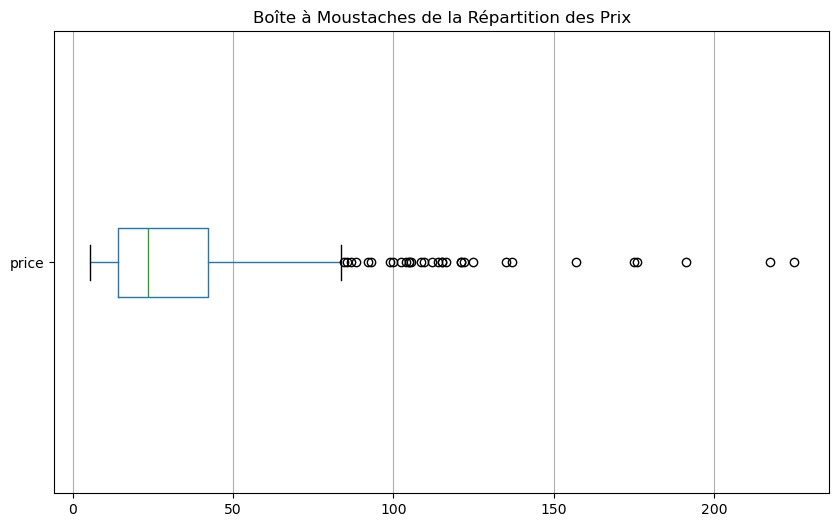

In [93]:
#Création d'une Boite à moustache de la répartition des prix grâce à Pandas

# Création de la boîte à moustaches
plt.figure(figsize=(10, 6))  # Définir la taille de la figure
df_erp_liaison_web.boxplot(column='price', vert=False)

# Ajout de titres et labels
plt.title('Boîte à Moustaches de la Répartition des Prix')
#plt.ylabel('Prix')
plt.grid(axis='y')  # Ajouter une grille sur l'axe y

# Affichage du graphique
plt.show()

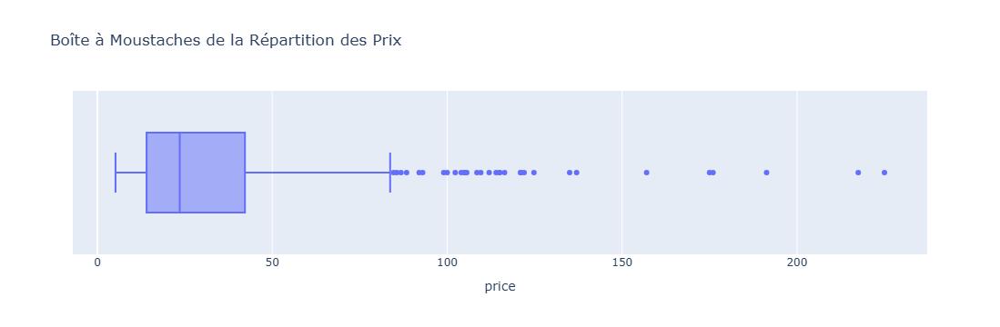

In [94]:
#Autre méthode avec plotly express
fig = px.box(df_erp_liaison_web, x='price', title='Boîte à Moustaches de la Répartition des Prix')

# Afficher la figure
fig.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 4.2 - Exploration par l'utisation de méthodes statistique</h3>
</div>

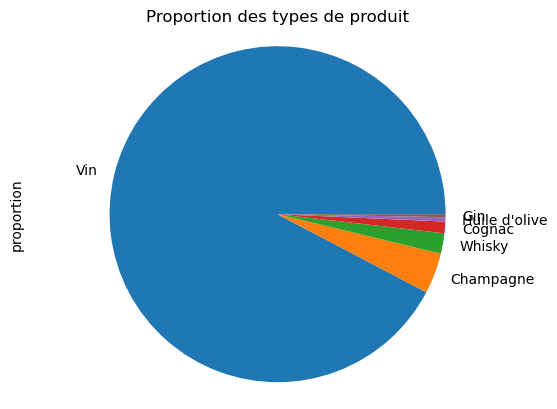

In [96]:
df_erp_liaison_web['product_type'].value_counts(normalize=True).plot(kind='pie')
plt.axis('equal')
plt.title('Proportion des types de produit')
plt.show()

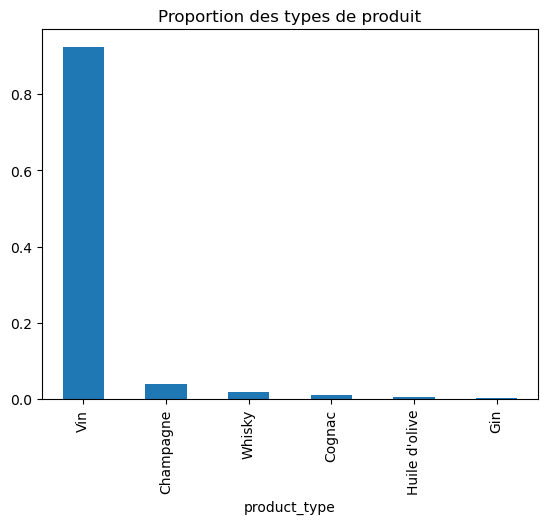

In [97]:
df_erp_liaison_web['product_type'].value_counts(normalize=True).plot(kind='bar')
plt.title('Proportion des types de produit')
plt.show()

----------------------------------------------------------------------------------------------------
Vin
moy:
 29.386515151515155
med:
 21.95
mod:
 0    19.0
Name: price, dtype: float64


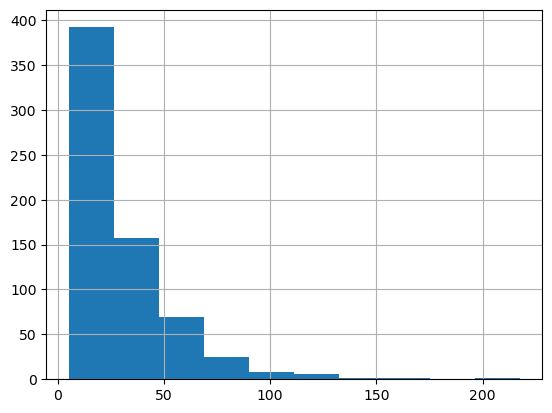

----------------------------------------------------------------------------------------------------
Champagne
moy:
 69.62678571428572
med:
 56.0
mod:
 0    39.0
1    49.0
2    59.0
3    79.5
Name: price, dtype: float64


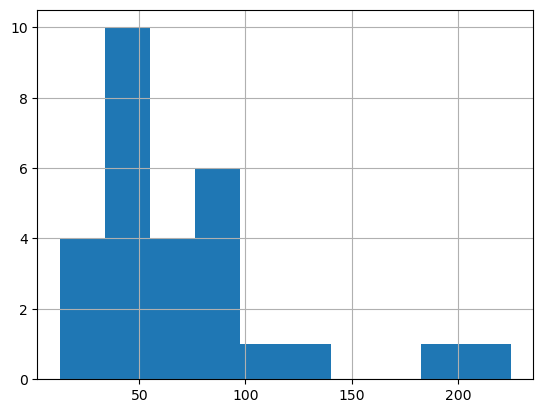

----------------------------------------------------------------------------------------------------
Cognac
moy:
 97.5
med:
 86.05
mod:
 0     44.0
1     59.9
2     62.5
3     68.1
4    104.0
5    108.5
6    157.0
7    176.0
Name: price, dtype: float64


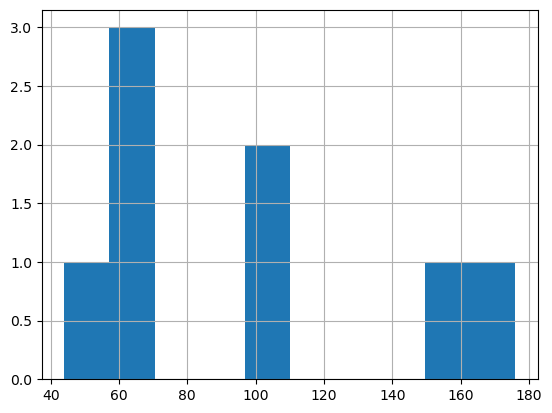

----------------------------------------------------------------------------------------------------
Huile d'olive
moy:
 24.933333333333337
med:
 19.5
mod:
 0    13.1
1    19.5
2    42.2
Name: price, dtype: float64


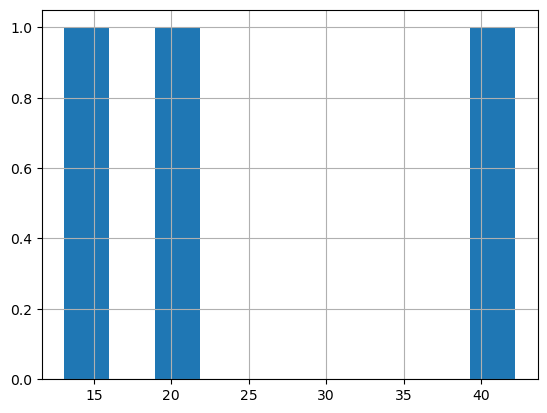

----------------------------------------------------------------------------------------------------
Whisky
moy:
 65.55714285714285
med:
 59.0
mod:
 0    49.5
1    59.0
Name: price, dtype: float64


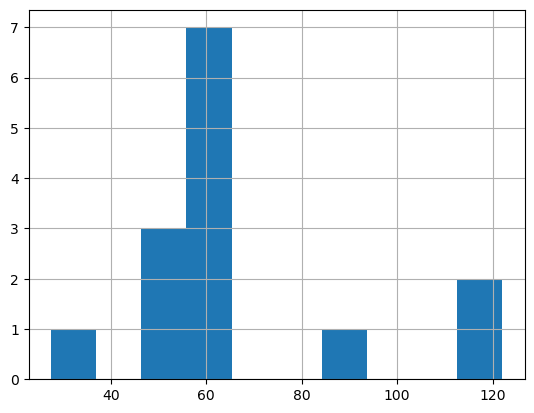

----------------------------------------------------------------------------------------------------
Gin
moy:
 36.0
med:
 36.0
mod:
 0    36.0
Name: price, dtype: float64


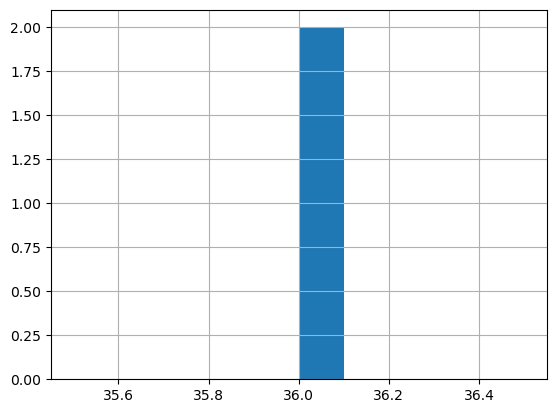

----------------------------------------------------------------------------------------------------
nan
moy:
 nan
med:
 nan
mod:
 Series([], Name: price, dtype: float64)


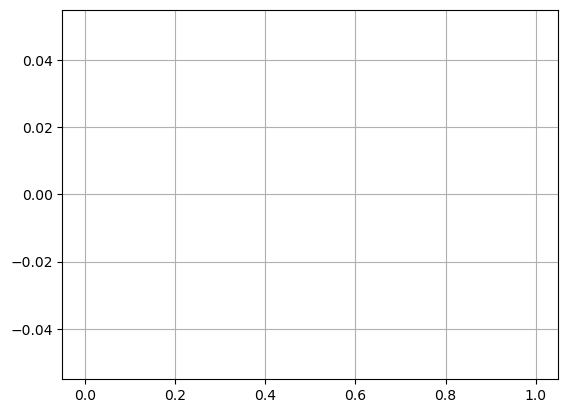

In [98]:
for cat in df_erp_liaison_web['product_type'].unique():
    subset = df_erp_liaison_web.loc[df_erp_liaison_web['product_type'] == cat, :] # Création du sous-échantillon
    print("-"*100)
    print(cat)
    print("moy:\n",subset['price'].mean())
    print("med:\n",subset['price'].median())
    print("mod:\n",subset['price'].mode())
    subset["price"].hist() # Crée l'histogramme
    plt.show() # Affiche l'histogramme

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 4.2.1 - Identification par le Z-index</h3>
</div>

In [100]:
#Calculer la moyenne du prix
moyenne_prix = round(df_erp_liaison_web['price'].mean(),2)

print(f"La moyenne du prix est de : {moyenne_prix} €")
print()


La moyenne du prix est de : 32.42 €



In [101]:
#Calculer l'écart-type du prix
ecart_type_prix = round(df_erp_liaison_web['price'].std(ddof=0),2)

print(f"L'écart-type du prix est : {ecart_type_prix} €")
print()


L'écart-type du prix est : 27.61 €



In [102]:
# Mod du prix 
mod = round(df_erp_liaison_web['price'].mode(),2)

print(f"Le mod : {mod}")
print()

Le mod : 0    19.0
Name: price, dtype: float64



In [103]:
# Variance du prix 
variance = round(df_erp_liaison_web['price'].var(ddof=0),2)

print(f"La variance empirique est de : {variance}")
print()


La variance empirique est de : 762.36



In [104]:
# Mesure de forme Skewness
skewness =  round(df_erp_liaison_web['price'].skew(),2)

print(f"Le skewness empirique est : {skewness}")
print()

Le skewness empirique est : 2.59



In [105]:
#Calculer le Z-score
df_erp_liaison_web['z_score'] = round((df_erp_liaison_web['price'] - moyenne_prix) / ecart_type_prix,2)

# Afficher  le Z-score
display(df_erp_liaison_web)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge,z_score
0,4729,1.0,8.60,26.0,instock,4.22,38,38,10.0,taxable,2018-04-18 12:25:58,Vin,Emile Boeckel Crémant Brut Blanc de Blancs,"Ce Crémant est vif et délicat, gourmand et croquant avec une bulle dynamique. Un excellent rapport qualité-prix.",https://www.bottle-neck.fr/?post_type=product&#038;p=4729,product,38.0,both,-0.86
1,4634,1.0,41.00,11.0,instock,20.12,41,41,6.0,taxable,2018-04-14 12:01:43,Vin,Marcel Windholtz Eau de Vie de Marc de Gewurztraminer,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4634,product,41.0,both,0.31
2,4141,1.0,39.00,123.0,instock,24.86,304,304,8.0,taxable,2018-02-13 12:57:44,Champagne,Champagne Gosset Grande Réserve,"Le nez, ouvert et expressif, évoque les fruits rouges mûrs (cassis), le froment, les fruits secs, le pain d’épice, la confiture de vieux garçon...La bouche est dominée par une tension minérale rafraîchissante associée à un goût chaleureux et consistant faisant écho à la richesse et au charnu du vin. Sous une expression dense de fruits mûrs et secs, apparaît en filigrane une fraîcheur discrète. Une ossature subtile et racée, signature des champagnes Gosset.",https://www.bottle-neck.fr/?post_type=product&#038;p=4141,product,304.0,both,0.24
3,5932,1.0,59.90,13.0,instock,27.18,523,523,0.0,taxable,2019-04-06 15:25:58,Cognac,Cognac Normandin Mercier VFC,"Issus des meilleurs crus de Grande et de Petite Champagne, ces cognacs sont sélectionnés avec la plus grande exigence, puis élevés dans les chais traditionnels aux portes de La Rochelle. Vieille Fine Champagne, douce et équilibrée avec un agréable bouquet floral.\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5932,product,523.0,both,1.00
4,5047,1.0,22.50,76.0,instock,13.78,531,531,8.0,taxable,2018-07-18 15:58:02,Champagne,Champagne Petit Lebrun &amp; Fils Blanc de Blancs Grand Cru,"Cuvée bien équilibrée à la fois vive et souple, l'attaque en bouche est franche, droite. La bouche est légère, complexe et consistante, alliant souplesse et vigueur. La finale est rémanente, longue. L'ensemble de la dégustation laisse des impressions de fraîcheur, de gras.",https://www.bottle-neck.fr/?post_type=product&#038;p=5047,product,531.0,both,-0.36
5,4631,1.0,76.80,1.0,instock,38.49,791,791,1.0,taxable,2018-04-14 11:54:47,Vin,Marcel Windholtz Eau de Vie de Baie de Houx,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4631,product,791.0,both,1.61
6,4630,1.0,62.40,1.0,instock,33.21,793,793,1.0,taxable,2018-04-14 11:52:20,Vin,Marcel Windholtz Eau de Vie de Coing,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à d

In [106]:
#Quel est le seuil prix dont z-score est supérieur à 3?
print(f"Z-score min : {df_erp_liaison_web['z_score'].min()}")
print(f"Z-score max : {df_erp_liaison_web['z_score'].max()}")
print(f"Z-score moyenne : {df_erp_liaison_web['z_score'].mean()}")
print(f"Z-score somme : {df_erp_liaison_web['z_score'].sum()}")

# Filtrer les prix avec Z-score supérieur à 3 en utilisant .loc
prix_seuil = df_erp_liaison_web.loc[df_erp_liaison_web['z_score'] > 3, 'price']

# Récupérer la valeur maximale des prix correspondants
seuil_prix = prix_seuil.min()

print(f"Le seuil de prix dont le Z-score est supérieur à 3 est : {seuil_prix}")

Z-score min : -0.99
Z-score max : 6.98
Z-score moyenne : -8.379888268156742e-05
Z-score somme : -0.060000000000002274
Le seuil de prix dont le Z-score est supérieur à 3 est : 116.4


In [107]:
# test zscore via scipy
df_erp_liaison_web['z-score2'] = stats.zscore(df_erp_liaison_web['price'])
display(df_erp_liaison_web)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge,z_score,z-score2
0,4729,1.0,8.60,26.0,instock,4.22,38,38,10.0,taxable,2018-04-18 12:25:58,Vin,Emile Boeckel Crémant Brut Blanc de Blancs,"Ce Crémant est vif et délicat, gourmand et croquant avec une bulle dynamique. Un excellent rapport qualité-prix.",https://www.bottle-neck.fr/?post_type=product&#038;p=4729,product,38.0,both,-0.86,-0.862783
1,4634,1.0,41.00,11.0,instock,20.12,41,41,6.0,taxable,2018-04-14 12:01:43,Vin,Marcel Windholtz Eau de Vie de Marc de Gewurztraminer,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4634,product,41.0,both,0.31,0.310670
2,4141,1.0,39.00,123.0,instock,24.86,304,304,8.0,taxable,2018-02-13 12:57:44,Champagne,Champagne Gosset Grande Réserve,"Le nez, ouvert et expressif, évoque les fruits rouges mûrs (cassis), le froment, les fruits secs, le pain d’épice, la confiture de vieux garçon...La bouche est dominée par une tension minérale rafraîchissante associée à un goût chaleureux et consistant faisant écho à la richesse et au charnu du vin. Sous une expression dense de fruits mûrs et secs, apparaît en filigrane une fraîcheur discrète. Une ossature subtile et racée, signature des champagnes Gosset.",https://www.bottle-neck.fr/?post_type=product&#038;p=4141,product,304.0,both,0.24,0.238235
3,5932,1.0,59.90,13.0,instock,27.18,523,523,0.0,taxable,2019-04-06 15:25:58,Cognac,Cognac Normandin Mercier VFC,"Issus des meilleurs crus de Grande et de Petite Champagne, ces cognacs sont sélectionnés avec la plus grande exigence, puis élevés dans les chais traditionnels aux portes de La Rochelle. Vieille Fine Champagne, douce et équilibrée avec un agréable bouquet floral.\n\n&nbsp;",https://www.bottle-neck.fr/?post_type=product&#038;p=5932,product,523.0,both,1.00,0.995185
4,5047,1.0,22.50,76.0,instock,13.78,531,531,8.0,taxable,2018-07-18 15:58:02,Champagne,Champagne Petit Lebrun &amp; Fils Blanc de Blancs Grand Cru,"Cuvée bien équilibrée à la fois vive et souple, l'attaque en bouche est franche, droite. La bouche est légère, complexe et consistante, alliant souplesse et vigueur. La finale est rémanente, longue. L'ensemble de la dégustation laisse des impressions de fraîcheur, de gras.",https://www.bottle-neck.fr/?post_type=product&#038;p=5047,product,531.0,both,-0.36,-0.359357
5,4631,1.0,76.80,1.0,instock,38.49,791,791,1.0,taxable,2018-04-14 11:54:47,Vin,Marcel Windholtz Eau de Vie de Baie de Houx,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjuguent pour que la réussite soit présente au creux de votre verre à dégustation... D'abord on ne s'improvise pas distillateur: chez les Windholtz ce sont trois générations qui ont accumulé le plein d'expérience dans l'art subtil de ""séparer par la chaleur les principes fixes et volatiles"".\nEnsuite entre moûts et alambic au long col, au milieu des vapeurs, c'est le savoir-faire qui préside à la transmutation mystérieuse et réfléchie destinées à sublimer et à faire chanter les fruits...",https://www.bottle-neck.fr/?post_type=product&#038;p=4631,product,791.0,both,1.61,1.607264
6,4630,1.0,62.40,1.0,instock,33.21,793,793,1.0,taxable,2018-04-14 11:52:20,Vin,Marcel Windholtz Eau de Vie de Coing,"Les eaux de vie naissent d'une subtile alchimie où deux éléments fondamentaux se conjugue

moyenne log price : 3.21
seuil outliers : 5.37


,product_type,price,post_title
204,Vin,217.5,David Duband Charmes-Chambertin Grand Cru 2014
567,Champagne,225.0,Champagne Egly-Ouriet Grand Cru Millésimé 2008


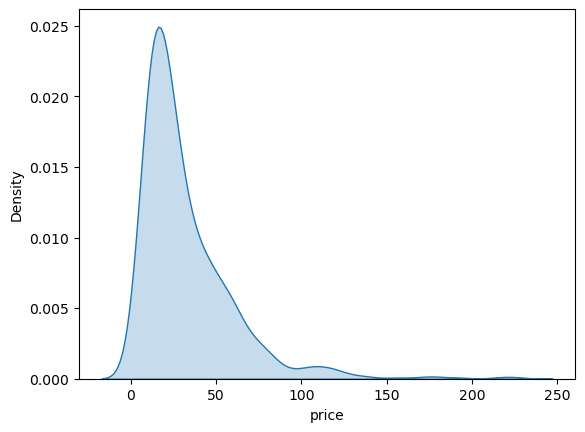

In [108]:

sns.kdeplot(df_erp_liaison_web['price'], fill=True)

print(f"moyenne log price : {round(np.log(df_erp_liaison_web['price']).mean(),2)}")
print(f"seuil outliers : {round(np.log(df_erp_liaison_web['price']).std()*3+np.log(df_erp_liaison_web['price']).mean(),2)}")

df_erp_liaison_web.loc[np.log(df_erp_liaison_web['price'])>5.37,['product_type','price', 'post_title'] ]

<Axes: xlabel='price', ylabel='Density'>

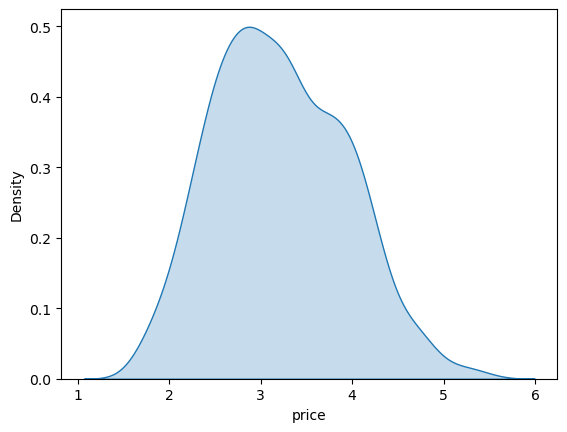

In [109]:

sns.kdeplot(np.log(df_erp_liaison_web['price']), fill=True)

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 4.2.2 - Identification par l'interval interquartile</h3>
</div>

In [111]:
#Utilisation de la fonction describe de Pandas pour l'etude des mesures de dispersions
statistiques = round(df_erp_liaison_web['price'].describe(),2)

# Afficher les statistiques descriptives
print(statistiques)

count    716.00
mean      32.42
std       27.63
min        5.20
25%       14.09
50%       23.55
75%       42.20
max      225.00
Name: price, dtype: float64


In [112]:
#Définissez un seuil pour les articles "outliers" en prix

Q1 = df_erp_liaison_web['price'].quantile(0.25)
Q3 = df_erp_liaison_web['price'].quantile(0.75)
IQR = Q3 - Q1

print(f"Q1 : {Q1}")
print(f"Q3 : {Q3}")
print(f"IQR : {IQR}")


Q1 : 14.0875
Q3 : 42.2
IQR : 28.112500000000004


In [113]:

# Définir les seuils
limite_inferieur = Q1 - 1.5 * IQR
limite_superieur = Q3 + 1.5 * IQR

# Filtrer les outliers
outliers = df_erp_liaison_web[(df_erp_liaison_web['price'] < limite_inferieur) | (df_erp_liaison_web['price'] > limite_superieur)]


print(f"limite_inferieur : {limite_inferieur}")
print(f"limite_superieur : {limite_superieur}")
print()

limite_inferieur : -28.081250000000004
limite_superieur : 84.36875



In [114]:
# Affiche outliers
display(outliers)

,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge,z_score,z-score2
22,4404,1.0,108.5,17.0,instock,52.22,3507,3507,4.0,taxable,2018-03-22 11:32:55,Cognac,Cognac Frapin Château de Fontpinot XO,"Exclusivement vendangé, distillé, vieilli et mis en bouteille numérotées au Château familial, ce cognac Grande Champagne revendique l'appellation ""Château"" qui lui confère sa rareté. Cette très vieille réserve du Château doit sa maturité exceptionnelle de 41° et sa qualité à un long vieillissement en chais secs. Son bouquet floral est dû à une distillation sur lies qui lui apporte élégance, finesse et persistance des arômes.",https://www.bottle-neck.fr/?post_type=product&#038;p=4404,product,3507.0,both,2.76,2.755365
23,4407,1.0,104.0,14.0,instock,46.71,3509,3509,5.0,taxable,2018-03-22 11:49:53,Cognac,Cognac Frapin Cigar Blend,"Ce cognac bénéficie d'un vieillissement plus long en fûts neufs, lui donnant un goût légèrement plus corsé. De couleur acajou ambré, son vieillissement lui confère un bouquet très tannique (vanille) mêlé aux notes de Porto et de fruits confits (miel et épices), caractéristiques d'une longue maturation. Charpenté, ce cognac se distingue des autres par sa forte personnalité, mais il reste long et équilibré.",https://www.bottle-neck.fr/?post_type=product&#038;p=4407,product,3509.0,both,2.59,2.592386
24,4402,1.0,176.0,11.0,instock,78.25,3510,3510,3.0,taxable,2018-03-22 11:21:05,Cognac,Cognac Frapin VIP XO,"La cuvée VIP XO à été enrichie d’eaux-de-vie très anciennes, allie âge, rondeur, bouquet et finesse. Ce sont les vieilles réserves de la famille FRAPIN. Au nez le VIP XO se distingue par d’agréables notes florales et une belle complexité aromatique ponctuée de subtiles touches boisées. Un ensemble élégant typique des vieux Cognacs de Grande Champagne. Après la délicatesse olfactive, la puissance en bouche surprend le dégustateur. Il offre un florilège de saveurs, révélant tour à tour des notes chocolatées, de\nfruits secs, de fruits confits, de pain d’épices… l’expression est sophistiquée, complexe, profonde, sans jamais perdre la fraîcheur originelle du fruit. Composé avec la précision d’un sonnet, le VIP XO est une ode à la passion de la création et du goût.",https://www.bottle-neck.fr/?post_type=product&#038;p=4402,product,3510.0,both,5.20,5.200060
33,4406,1.0,157.0,12.0,instock,69.08,7819,7819,4.0,taxable,2018-03-22 11:42:48,Cognac,Cognac Frapin Château de Fontpinot 1989 20 Ans d'Age,"Eau-de-Vie distillée à partir de raisins de Grande Champagne, premier cru de la région de Cognac, récoltés exclusivement au Château de Fontpinot en 1989, année la plus chaude de la décennie.. Un Cognac vanillé, tout en rondeur et puissance avec un final très prononcé de fruits confits avec des notes très légèrement poivrées.",https://www.bottle-neck.fr/?post_type=product&#038;p=4406,product,7819.0,both,4.51,4.511924
53,6214,1.0,99.0,9.0,instock,49.62,11601,11601,6.0,taxable,2019-07-25 09:15:41,Vin,Domaine des Comtes Lafon Volnay 1er Cru Champans 2013,"La couleur rouge intense annonce un belle concentration, le nez évoque les fruits rouges, légèrement épicé, la bouche d'une très grande élégance livre une texture onctueuse et soyeuse malgré une structure bien présente.",https://www.bottle-neck.fr/?post_type=product&#038;p=6214,product,11601.0,both,2.41,2.411297
54,5008,1.0,105.0,12.0,instock,56.42,11602,11602,7.0,taxable,2018-07-17 10:52:41,Vin,Domaine des Comtes Lafon Volnay 1er Cru Santenots du Milieu 2013,"""Il s'agit là de la meilleure partie de l'appellation Santenots, autrefois classée tête de cuvée par le docteur Lavalle"". <span class=""font5"">Voilà qui nous plonge dans le bain de cette cuvée emblématique du domaine qui fut assemblée pièce par pièce, tel un puzzle, par le comte Jules Lafon. Ces 3 ha de vignes situées sur le village de Meursault et non de Volnay, sont enracinés sur une terre

In [115]:
#Définissez le nombre d'articles et la proportion de l'ensemble du catalogue "outliers"

#Le nombre d'articles "outliers"
nb_outliers = len(outliers)
print(f"Le nombre d'articles outliers : {nb_outliers}")
print()

#Proportion de outliers
total_article = len(df_erp_liaison_web)
print(f"Le nombre total d'articles : {total_article}")
print()

proportion_outliers = nb_outliers / total_article * 100
print(f"La proportion d'outliers dans l'ensemble du catalogue : {proportion_outliers:.2f}%")

Le nombre d'articles outliers : 32

Le nombre total d'articles : 716

La proportion d'outliers dans l'ensemble du catalogue : 4.47%


In [116]:
#Selon vous, ces outliers sont-ils justifiés ? Comment le démontrer si cela est possible ?
unique_type_produit = outliers['product_type'].unique()
unique_type_produit = unique_type_produit[~pd.isna(unique_type_produit)]

print(f"Différent type produit chez les outliers : {unique_type_produit}")
print()

# Repartition outliers par type produit
outliers_par_type = outliers['product_type'].value_counts(dropna=True) 

display(outliers_par_type)


Différent type produit chez les outliers : ['Cognac' 'Vin' 'Champagne' 'Whisky']



product_type
Vin          19
Champagne     6
Cognac        4
Whisky        3
Name: count, dtype: int64

<div style="background-color: RGB(51,165,182);" >
<h2 style="margin: auto; padding: 20px; color:#fff; ">Etape 5 - Analyse univarié du CA, des quantités vendues, des stocks et de la marge ainsi qu'une analyse multivarié  </h2>
</div>

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.1 - Analyse des ventes en CA</h3>
</div>

In [119]:
##############################
# Calculer le CA su site web #
##############################

#Créez une colonne calculant le CA par article
df_erp_liaison_web['ca_par_article'] = df_erp_liaison_web['price']*df_erp_liaison_web['total_sales']

#Calculez la somme de la colonne "ca_par_article"
#Ce résultat correspond au chiffre d'affaire du site web
ca_web = df_erp_liaison_web['ca_par_article'].sum()
print(f"Le chiffre d'affaires du site web est de {ca_web} €")


Le chiffre d'affaires du site web est de 139815.40000000002 €


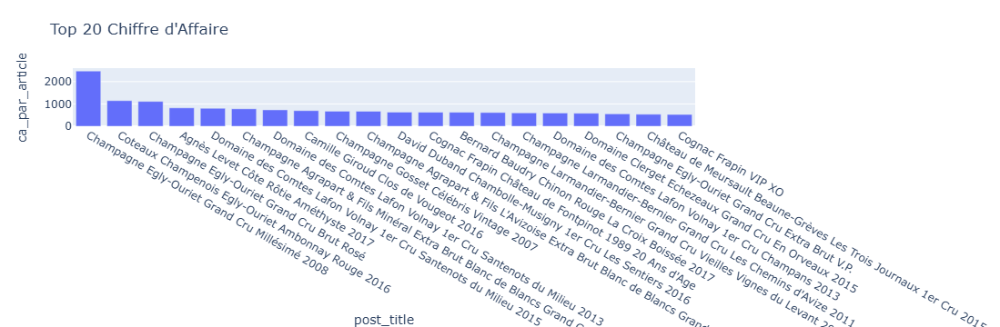

In [120]:
###############################
# Palmares des articles en CA #
###############################

#Effectuer le tri dans l'ordre décroissant du CA du dataset df_merge
df_top_ca = df_erp_liaison_web.sort_values(by="ca_par_article",ascending=False)

#Réinitialiser l'index du dataset par un reset_index
df_top_ca = df_top_ca.reset_index()

#Afficher les 20 premier articles en CA
df_top_20_ca = df_top_ca.head(20)

#Graphique en barre des 20 premiers articles avec plotly express

# Création du graphique en barres
fig = px.bar(
    df_top_20_ca,
    y="ca_par_article",
    x="post_title",
    title="Top 20 Chiffre d'Affaire"
)
fig.show()


In [121]:
#############################
# Calculer le 20 / 80 en CA #
#############################


#Créer une colonne calculant la part du CA de la ligne dans le dataset
df_erp_liaison_web['pourcentage_ca'] = round(df_erp_liaison_web['ca_par_article'] / ca_web *100,3)

#Créer une colonne réalisant la somme cumulative de la colonne précedemment créée
df_erp_liaison_web = df_erp_liaison_web.sort_values(by="ca_par_article",ascending=False)
df_erp_liaison_web['cumul_ca'] = df_erp_liaison_web['pourcentage_ca'].cumsum()

#Grâce au deux colonnes créées précedemment, calculer le nombre d'articles représentant 80% du CA
nb_article_80_pourcent_ca = (df_erp_liaison_web['cumul_ca']<= 80).sum()
print(f"Nombre d'article représentant 80% du CA : {nb_article_80_pourcent_ca}")

#Afficher la proportion que représentent ce groupe d'articles dans le catalogue entier du site web
proportion_nb_article_80_pourcent_ca = round(nb_article_80_pourcent_ca / total_article * 100,2)
print(f"Les articles qui représentent 80% du CA représentent  : {proportion_nb_article_80_pourcent_ca} % de l'ensemble des articles")


Nombre d'article représentant 80% du CA : 413
Les articles qui représentent 80% du CA représentent  : 57.68 % de l'ensemble des articles


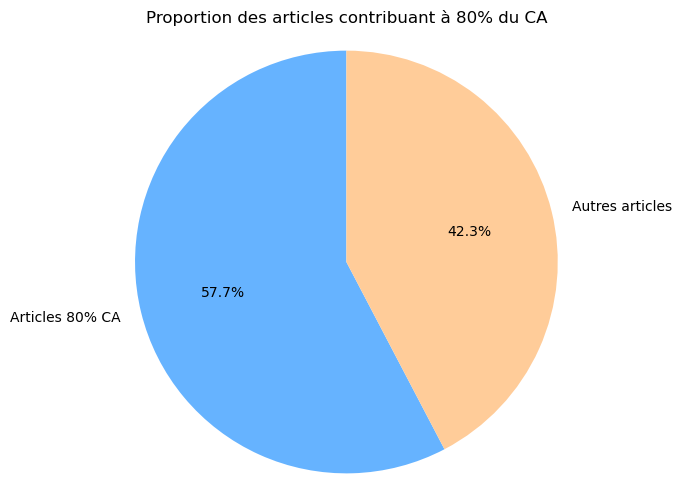

In [122]:

# Labels et données pour le graphique
labels = ['Articles 80% CA', 'Autres articles']
reste = 100 - proportion_nb_article_80_pourcent_ca
sizes = [proportion_nb_article_80_pourcent_ca, reste]
colors = ['#66b3ff', '#ffcc99']

# Création du camembert
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title('Proportion des articles contribuant à 80% du CA')
plt.axis('equal')  # Assure un cercle parfait
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.2 - Analyse des ventes en Quantités</h3>
</div>

Le nombre total de ventes 5678.0 


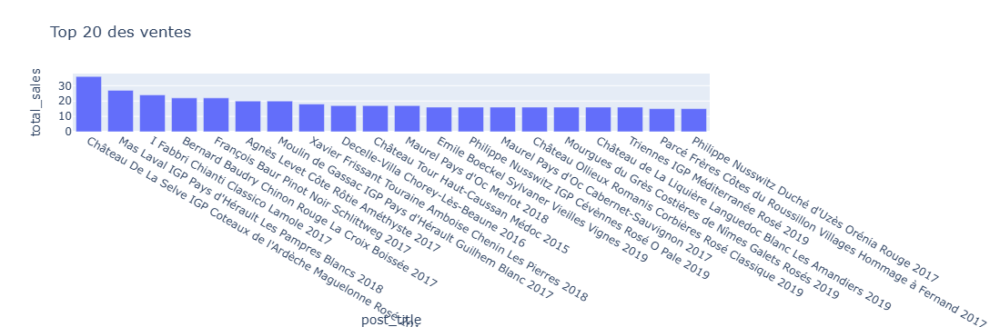

In [124]:
#####################################
# Palmares des articles en quantité #
#####################################

#Calculez la somme de la colonne "ca_par_article"
#Ce résultat correspond au chiffre d'affaire du site web
ventes = df_erp_liaison_web['total_sales'].sum()
print(f"Le nombre total de ventes {ventes} ")

#Effectuer le tri dans l'ordre décroissant de quantités vendues du dataset df_merge
df_top_sales = df_erp_liaison_web.sort_values(by="total_sales",ascending=False)

#Réinitialiser l'index du dataset par un reset_index
df_top_sales = df_top_sales.reset_index()

#Afficher les 20 premier articles en quantité
top_20_sales = df_top_sales.head(20)

#Graphique en barre des 20 premiers articles avec plotly express
fig = px.bar(
    top_20_sales,
    y="total_sales",
    x="post_title",
    title="Top 20 des ventes"
)
fig.show()

In [125]:
#############################
# Calculer le 20 / 80 en Vente #
#############################

#Créer une colonne calculant la part en quantité de la ligne dans le dataset
total_quantité_vendues = df_erp_liaison_web['total_sales'].sum()
df_erp_liaison_web['pourcentage_sales'] = round(df_erp_liaison_web['total_sales'] / total_quantité_vendues *100,3)

#Créer une colonne réalisant la somme cumulative de la colonne précedemment créée
df_erp_liaison_web = df_erp_liaison_web.sort_values(by="pourcentage_sales",ascending=False)
df_erp_liaison_web['cumul_sales'] = df_erp_liaison_web['pourcentage_sales'].cumsum()

#Grâce au deux colonnes créées précedemment, calculer le nombre d'articles représentant 80% des ventes en quantité
nb_article_80_pourcent_sales = (df_erp_liaison_web['cumul_sales']<= 80).sum()
print(f"Nombre d'article représentant 80% des ventes : {nb_article_80_pourcent_sales}")

#Afficher la proportion que représentent ce groupe d'articles dans le catalogue entier du site web
proportion_nb_article_80_pourcent_sales = round(nb_article_80_pourcent_sales / total_article * 100,2)
print(f"Les articles qui représentent 80% des ventes représentent de  : {proportion_nb_article_80_pourcent_sales} % de l'ensemble des articles")

Nombre d'article représentant 80% des ventes : 424
Les articles qui représentent 80% des ventes représentent de  : 59.22 % de l'ensemble des articles


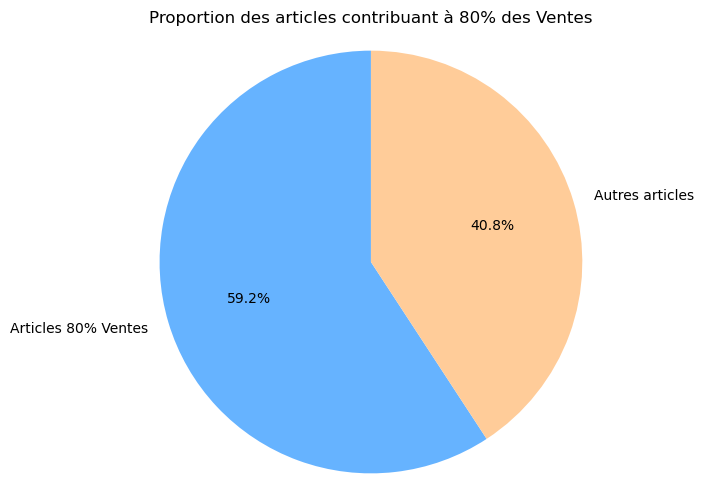

In [126]:

# Labels et données pour le graphique
labels = ['Articles 80% Ventes', 'Autres articles']
reste = 100 - proportion_nb_article_80_pourcent_sales
sizes = [proportion_nb_article_80_pourcent_sales, reste]
colors = ['#66b3ff', '#ffcc99']

# Création du camembert
plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title('Proportion des articles contribuant à 80% des Ventes')
plt.axis('equal')  # Assure un cercle parfait
plt.show()

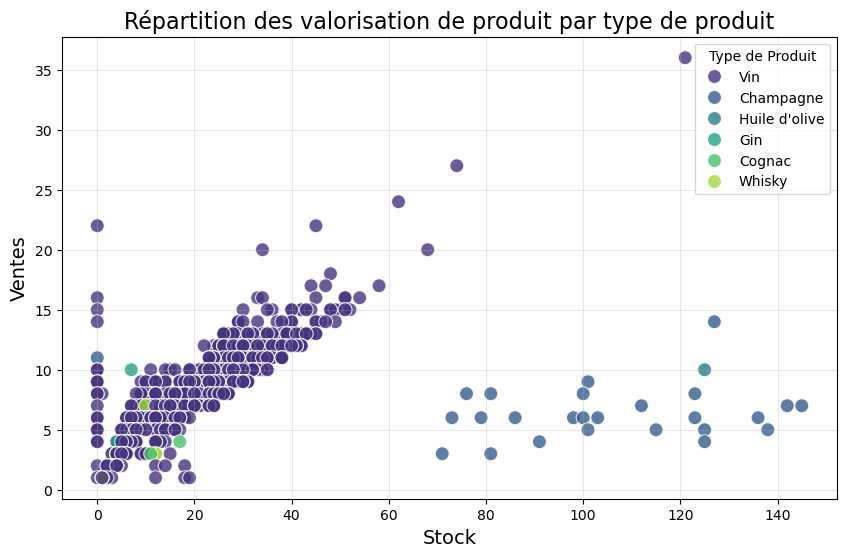

In [127]:
# Création du scatter plot

data_sales = df_erp_liaison_web[df_erp_liaison_web['total_sales'] > 0]

plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=data_sales, 
    x='stock_quantity', 
    y='total_sales', 
    hue='product_type',  # Différencie les couleurs selon product_type
    palette='viridis',   # Palette de couleurs
    s=100,               # Taille des points
    alpha=0.8            # Transparence
)

# Ajout des titres et légendes
plt.title('Répartition des valorisation de produit par type de produit', fontsize=16)
plt.xlabel('Stock', fontsize=14)
plt.ylabel('Ventes', fontsize=14)
plt.legend(title='Type de Produit')
plt.grid(True, alpha=0.3)
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.3 - Analyse des stocks</h3>
</div>

In [129]:
######################################
# Calcule le nombre de mois de stock #
######################################

#Import de numpy 

#Création de la colonne Rotation de stock
stock_initial = df_erp_liaison_web['stock_quantity'] + df_erp_liaison_web['total_sales']
stock_moyen = (stock_initial+df_erp_liaison_web['stock_quantity'])/2
df_erp_liaison_web['rotation_stock'] = round(df_erp_liaison_web['total_sales'] / stock_moyen,2)

#Remplacement des "inf" par 0
rotation_stock_values = {'rotation_stock':0}
df_erp_liaison_web.fillna(value=rotation_stock_values)

print(f"Rotation stock mininum : {df_erp_liaison_web['rotation_stock'].min()}")
print(f"Rotation stock maximum : {df_erp_liaison_web['rotation_stock'].max()}")
print(f"Rotation stock moyenne : {round(df_erp_liaison_web['rotation_stock'].mean(),2)}")
print(f"Rotation stock median : {round(df_erp_liaison_web['rotation_stock'].std(),2)}")


Rotation stock mininum : 0.0
Rotation stock maximum : 2.0
Rotation stock moyenne : 0.42
Rotation stock median : 0.33


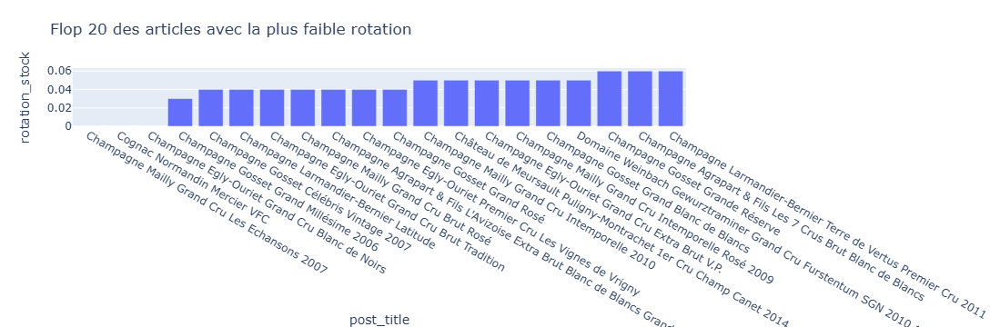

In [130]:
#Effectuer le tri dans l'ordre décroissant du nombre de mois de stock dans le dataset df_merge
df_flop_stock = df_erp_liaison_web.sort_values(by="rotation_stock")

#Réinitialiser l'index du dataset par un reset_index
df_flop_stock = df_flop_stock.reset_index()

#Afficher les 20 premier articles en quantité
flop_20_stock = df_flop_stock.head(20)

#Graphique en barre du flop 20 des produits qui ont le plus de mois de stock
fig = px.bar(
    flop_20_stock,
    y="rotation_stock",
    x="post_title",
    title="Flop 20 des articles avec la plus faible rotation"
)
fig.show()

In [131]:
####################################
# Valorisation des stocks en euros #
####################################


#Création de la colonne Valorisation des stocks en euros
df_erp_liaison_web['valorisation_stock'] = df_erp_liaison_web['purchase_price'] *df_erp_liaison_web['stock_quantity']

#Calculer la somme de la colonne "Valorisation_stock_euros"
total_valorisation_stock = round(df_erp_liaison_web['valorisation_stock'].sum(),2)
print(f"Total de la Valorisation stock : {total_valorisation_stock}€")


Total de la Valorisation stock : 277350.37€


In [132]:
##############################################
# Valorisation du nombre de produit en stock #
##############################################

#Calculer la somme de la colonne stock quantity
total_stock_quantity = df_erp_liaison_web['stock_quantity'].sum()
print(f"Total de la quantité de stock : {total_stock_quantity}")

Total de la quantité de stock : 16741.0


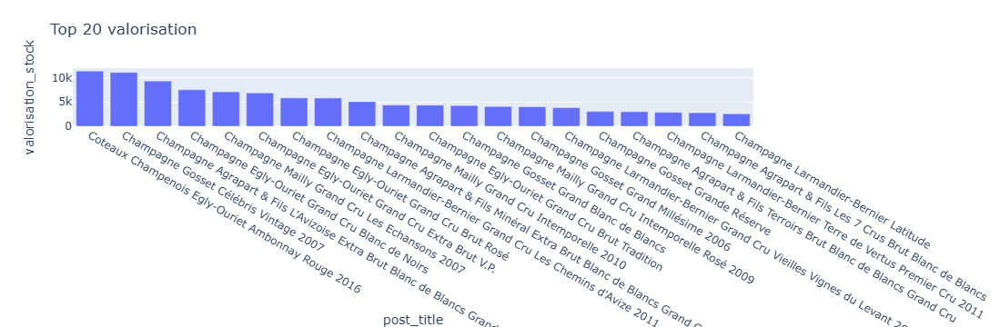

In [133]:

#Effectuer le tri dans l'ordre décroissant de quantités vendues du dataset df_merge
df_top_valo = df_erp_liaison_web.sort_values(by="valorisation_stock",ascending=False)

#Réinitialiser l'index du dataset par un reset_index
df_top_valo = df_top_valo.reset_index()

#Afficher les 20 premier articles 
top_20_valo = df_top_valo.head(20)

#Graphique en barre des 20 premiers articles avec plotly express
fig = px.bar(
    top_20_valo,
    y="valorisation_stock",
    x="post_title",
    title="Top 20 valorisation"
)
fig.show()

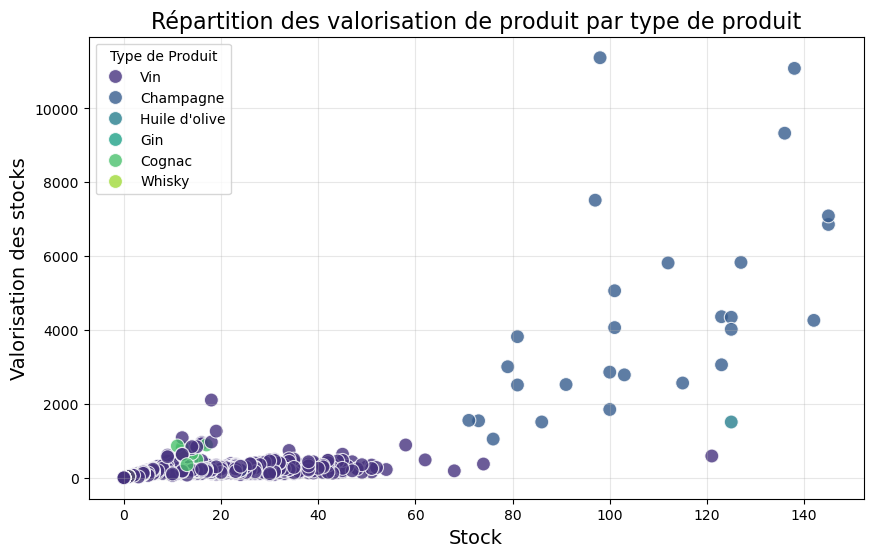

In [134]:
# Création du scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=df_erp_liaison_web, 
    x='stock_quantity', 
    y='valorisation_stock', 
    hue='product_type',  # Différencie les couleurs selon product_type
    palette='viridis',   # Palette de couleurs
    s=100,               # Taille des points
    alpha=0.8            # Transparence
)

# Ajout des titres et légendes
plt.title('Répartition des valorisation de produit par type de produit', fontsize=16)
plt.xlabel('Stock', fontsize=14)
plt.ylabel('Valorisation des stocks', fontsize=14)
plt.legend(title='Type de Produit')
plt.grid(True, alpha=0.3)
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.4 - Analyse du taux de marge</h3>
</div>

In [136]:
############################
# Analyse du taux de marge #
############################

#Création de la colonne prix HT
df_erp_liaison_web['prix_HT'] = df_erp_liaison_web['price'] - (df_erp_liaison_web['price']*0.2)

#Création de la colonne Taux de marge
df_erp_liaison_web['taux_marge'] = round(((df_erp_liaison_web['prix_HT'] - df_erp_liaison_web['purchase_price'])/df_erp_liaison_web['purchase_price'])*100,2)

#Afficher le taux minimum de la colonne "taux_marge"
taux_marge_min = df_erp_liaison_web['taux_marge'].min()
print(f"Le taux minimum de la colonne taux_marge : {taux_marge_min}")

#Afficher le taux maximum de la colonne "taux_marge"
taux_marge_max = df_erp_liaison_web['taux_marge'].max()
print(f"Le taux maximum de la colonne taux_marge : {taux_marge_max}")


Le taux minimum de la colonne taux_marge : -86.94
Le taux maximum de la colonne taux_marge : 83.76


In [137]:
#affichage de la ligne avec un taux de marge inférieur à 0
filtered_neg_marge_df = df_erp_liaison_web[df_erp_liaison_web['taux_marge'] < 0] 
print(f"Nombre d'article avec une marge négative : {filtered_neg_marge_df.shape[0]}")

# Afficher le DataFrame filtré 
display(filtered_neg_marge_df)

Nombre d'article avec une marge négative : 1


,product_id,onsale_web,price,stock_quantity,stock_status,purchase_price,id_web,sku,total_sales,tax_status,post_date,product_type,post_title,post_excerpt,guid,post_type,sku_numeric,_merge,z_score,z-score2,ca_par_article,pourcentage_ca,cumul_ca,pourcentage_sales,cumul_sales,rotation_stock,valorisation_stock,prix_HT,taux_marge
79,4355,1.0,12.65,97.0,instock,77.48,12589,12589,0.0,taxable,2018-03-02 10:46:10,Champagne,Champagne Egly-Ouriet Grand Cru Blanc de Noirs,"Le Blanc de Noirs représente le meilleur du savoir-faire de la maison Egly-Ouriet. C’est une cuvée d’une grande finesse. Ce champagne est élevé en fût de chêne et la fermentation malolactique est volontairement bloquée afin de conserver une grande tension. Il possède une robe vieil or, et des bulles d’une très grande finesse. Au nez, c’est une cuvée qui s’ouvre sur des arômes gourmands de fruits compotés, de fruits jaunes, et une touche d’épices. La bouche est superbe, mêlant à la fois fraîcheur, rondeur, tension. Une immense cuvée !",https://www.bottle-neck.fr/?post_type=product&#038;p=4355,product,12589.0,both,-0.72,-0.716101,0.0,0.0,102.77,0.0,101.302,0.0,7515.56,10.12,-86.94


In [138]:
#création d'un dataframe avec les taux positifs
filtered_pos_marge_df = df_erp_liaison_web[df_erp_liaison_web['taux_marge'] > 0]
#display(filtered_pos_marge_df)

#Afficher le minimum de la colonne "taux_marge"
taux_minimum = filtered_pos_marge_df['taux_marge'].min()
print(f"Taux minimum : {taux_minimum} %")

#Afficher le maximum de la colonne "taux_marge"
taux_maximum = filtered_pos_marge_df['taux_marge'].max()
print(f"Taux maximum : {taux_maximum} %")

#Afficher la moyenne de la colonne "taux_marge"
taux_moyen = filtered_pos_marge_df['taux_marge'].mean()
print(f"Taux moyen : {round(taux_moyen,2)} %")

#Afficher la mediane de la colonne "taux_marge"
taux_med = filtered_pos_marge_df['taux_marge'].median()
print(f"Taux mediane : {round(taux_med,2)} %")

Taux minimum : 24.32 %
Taux maximum : 83.76 %
Taux moyen : 54.76 %
Taux mediane : 54.82 %


In [139]:
#création d'un dataframe avec le taux de marge moyen par type de produit
filtered_mean_marge_df = df_erp_liaison_web.groupby('product_type').agg({'taux_marge':'mean'})
filtered_mean_marge_df['taux_marge'] = round(filtered_mean_marge_df['taux_marge'],2)
display(filtered_mean_marge_df)

,taux_marge
product_type,
Champagne,30.02
Cognac,75.03
Gin,67.83
Huile d'olive,28.06
Vin,55.02
Whisky,74.47


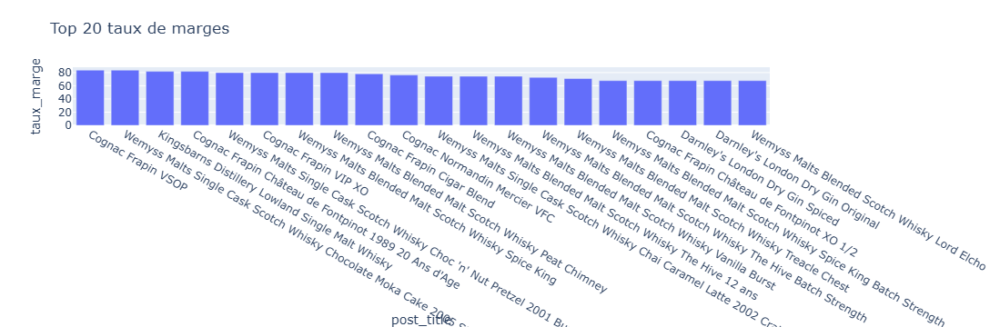

In [140]:
#Effectuer le tri dans l'ordre décroissant de quantités vendues du dataset df_merge
df_top_marge = df_erp_liaison_web[df_erp_liaison_web['taux_marge'] > 0]
df_top_marge = df_top_marge.sort_values(by="taux_marge",ascending=False)

#Réinitialiser l'index du dataset par un reset_index
df_top_marge = df_top_marge.reset_index()

#Afficher les 20 premier articles 
top_20_marge = df_top_marge.head(20)

#Graphique en barre des 20 premiers articles avec plotly express
fig = px.bar(
    top_20_marge,
    y="taux_marge",
    x="post_title",
    title="Top 20 taux de marges"
)
fig.show()

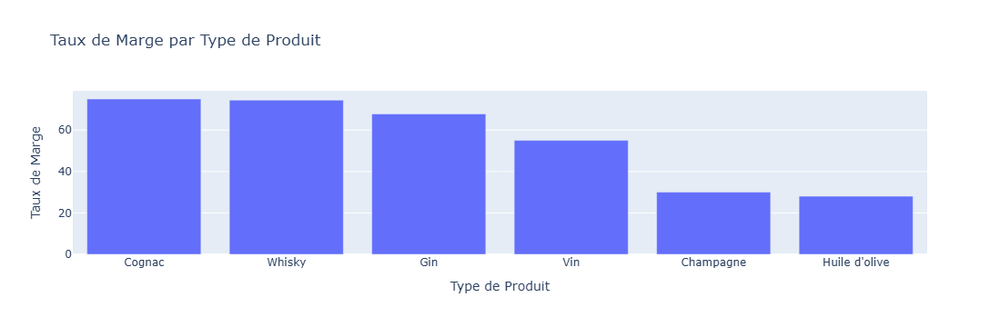

In [141]:
#Affichage dans un graphique du taux de marge par type de produit
filtered_mean_marge_df = filtered_mean_marge_df.sort_values(by="taux_marge",ascending=False)
fig = px.bar(filtered_mean_marge_df, y='taux_marge', title="Taux de Marge par Type de Produit", labels={'product_type': 'Type de Produit', 'taux_marge': 'Taux de Marge'}) 

# Afficher le graphique 
fig.show()

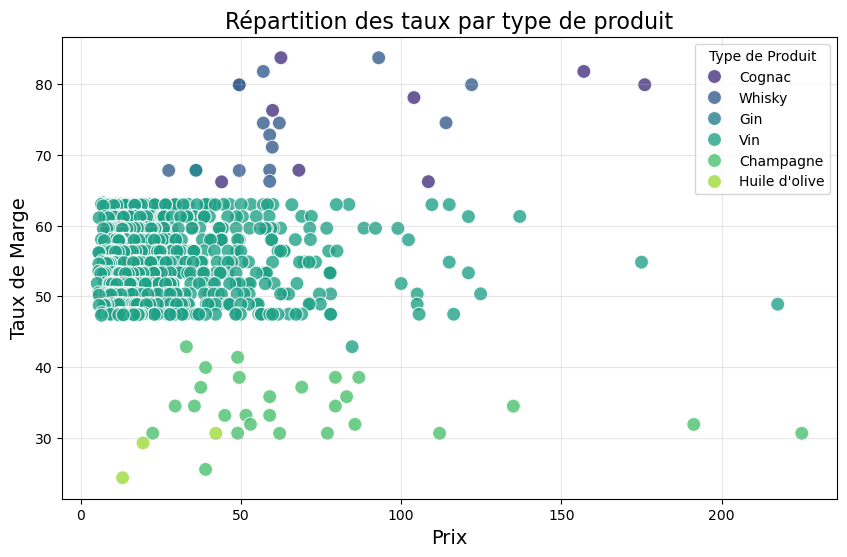

In [142]:
# Création du scatter plot Taux marge / prix
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=df_top_marge, 
    x='price', 
    #x='total_sales', 
    y='taux_marge', 
    hue='product_type',  # Différencie les couleurs selon product_type
    palette='viridis',   # Palette de couleurs
    s=100,               # Taille des points
    alpha=0.8            # Transparence
)

# Ajout des titres et légendes
plt.title('Répartition des taux par type de produit', fontsize=16)
plt.xlabel('Prix', fontsize=14)
plt.ylabel('Taux de Marge', fontsize=14)
plt.legend(title='Type de Produit')
plt.grid(True, alpha=0.3)
plt.show()

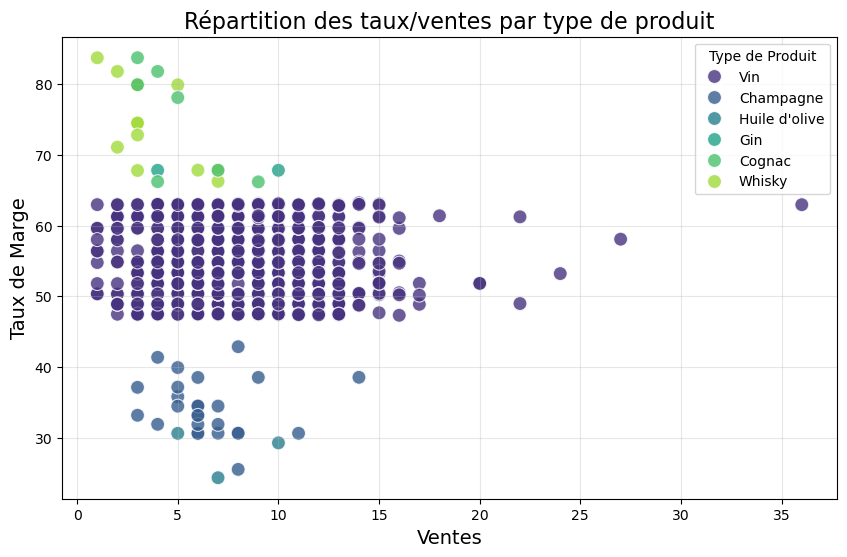

In [143]:
# Création du scatter plot Taux marge / Ventes
df_top_marge_vente = df_erp_liaison_web[df_erp_liaison_web['taux_marge'] > 0]
df_top_marge_vente = df_top_marge_vente[df_top_marge_vente['total_sales'] > 0]

plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=df_top_marge_vente, 
    x='total_sales', 
    y='taux_marge', 
    hue='product_type',  # Différencie les couleurs selon product_type
    palette='viridis',   # Palette de couleurs
    s=100,               # Taille des points
    alpha=0.8            # Transparence
)

# Ajout des titres et légendes
plt.title('Répartition des taux/ventes par type de produit', fontsize=16)
plt.xlabel('Ventes', fontsize=14)
plt.ylabel('Taux de Marge', fontsize=14)
plt.legend(title='Type de Produit')
plt.grid(True, alpha=0.3)
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.5 - Analyse des correlations entre les variables stock, sales et price</h3>
</div>

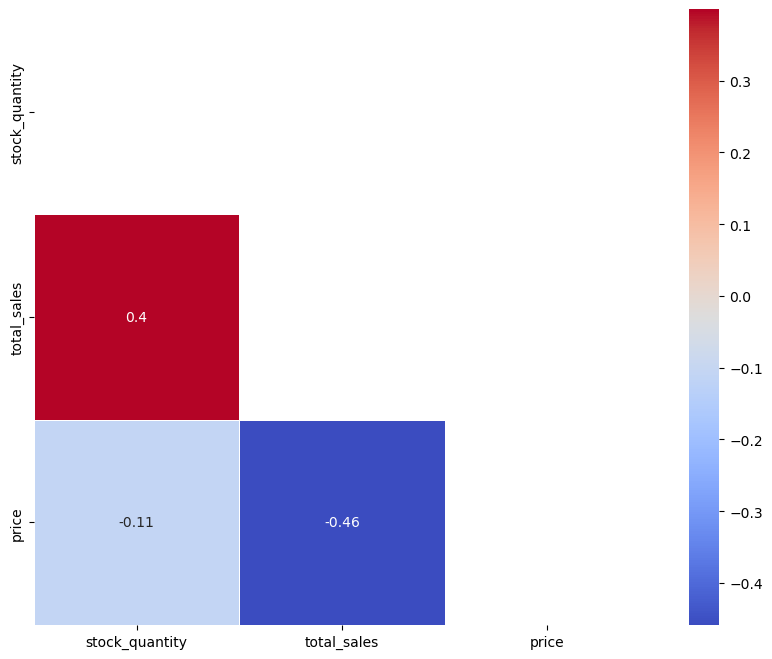

In [145]:
############################
# Analyse des correlations #
############################

#Création d'un heatmap de correlation avec les variables stock, sales et price
#on peut également créer un mask pour n'afficher qu'une demi heatmap

# Calcul de la matrice de corrélation
corr_matrice = df_erp_liaison_web[['stock_quantity', 'total_sales', 'price']].corr() 

# Créer un masque pour la heatmap
masque = np.triu(np.ones_like(corr_matrice, dtype=bool)) 

# Créer la figure et la heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrice, annot=True, mask=masque, cmap='coolwarm', square=True, linewidths=0.5)

# Afficher la heatmap
plt.show()

#Que peut-on conclure des correlations ? Que le stock a une forte corrélation avec le nb total de vente

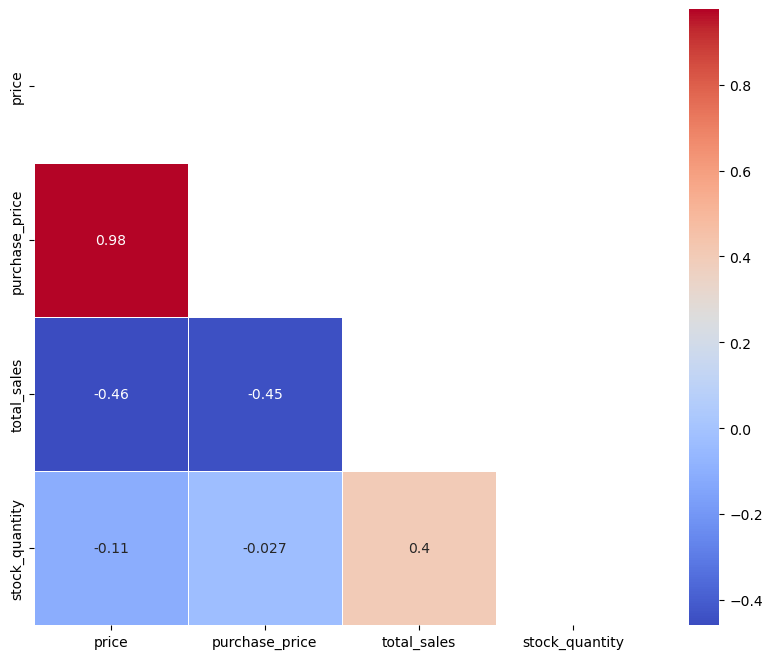

In [147]:

#Création d'un heatmap de correlation avec les variables stock, sales et price
#on peut également créer un mask pour n'afficher qu'une demi heatmap

# Calcul de la matrice de corrélation
corr_matrice = df_erp_liaison_web[['price','purchase_price', 'total_sales','stock_quantity']].corr() 

# Créer un masque pour la heatmap
masque = np.triu(np.ones_like(corr_matrice, dtype=bool)) 

# Créer la figure et la heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrice, annot=True, mask=masque, cmap='coolwarm', square=True, linewidths=0.5)

# Afficher la heatmap
plt.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Test Boite moustache produit</h3>
</div>

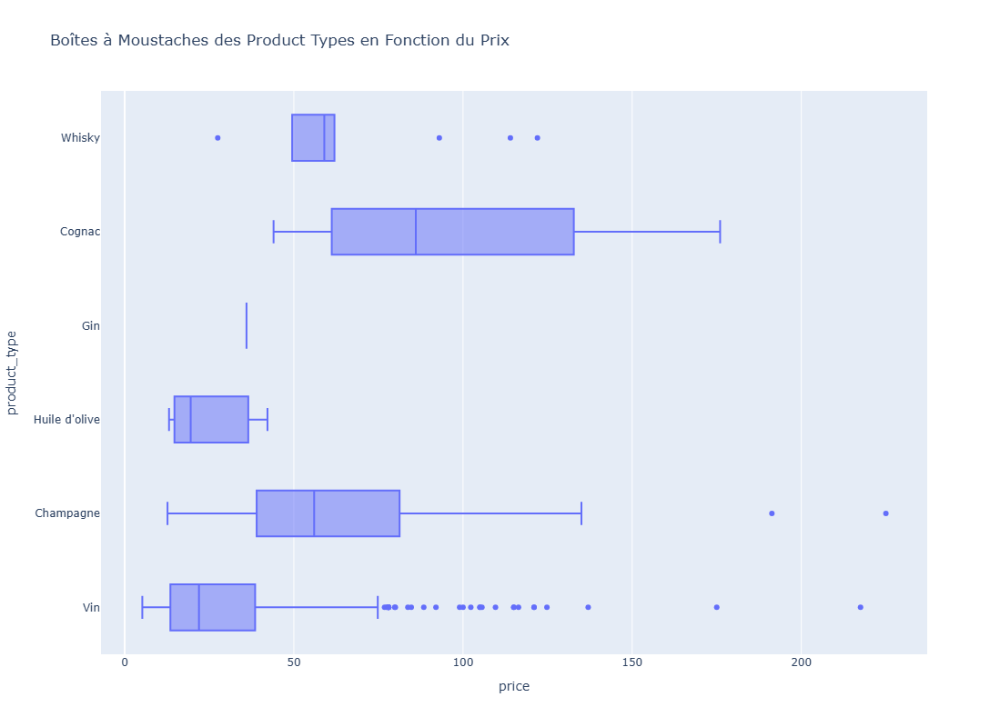

In [148]:
############################
# Boite à moustache par product_type #
############################

fig = px.box(df_erp_liaison_web, y='product_type', x='price', title="Boîtes à Moustaches des Product Types en Fonction du Prix",width=1000,height=800)

fig.show()

<div style="border: 1px solid RGB(51,165,182);" >
<h3 style="margin: auto; padding: 20px; color: RGB(51,165,182); ">Etape 5.6 - Mettre à disposition la nouvelle table sur un fichier Excel</h3>
</div>

In [150]:
#Mettre le dataset df_merge sur un fichier Excel
#Cette étape peut-être utile pour partager le résultat du dataset obtenu pour le partager avec les équipes.  
df_erp_liaison_web.to_excel('df_merge.xlsx', index=False)